## Import Necessary libraries

In [1]:
# Data manipulation
import pandas as pd
import numpy as np

# Visualization
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.style as style 

# Network analysis
import networkx as nx
from networkx.algorithms import community #This part of networkx, for community detection, needs to be imported separately.

# System
from operator import itemgetter

pd.set_option('display.float_format', lambda x: '%.3f' % x)

## User Tabel

#### To Do List
1. Gender Distribution
2. Users Distribution Based On Cities
3. Cites Registration Growth During Period Given
4. Monthly Registration
5. Daily Registration


#### Reading data

In [2]:
users_df = pd.read_csv('komodaa/users.csv')

#### Get familiar with data

In [3]:
users_df.head(5)

,uuid,city_uuid,gender,date
0,06abe0e5-c408-4a33-9d81-5bfacc891f15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33
1,33d7f40c-ab30-4517-881c-24d61acc62b8,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33
2,392e5ac0-fd87-4ea0-b9e4-bfffe077cca4,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33
3,16848d64-b555-4182-a5b4-c0ae1e850e01,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33
4,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33


In [4]:
# check columns type
users_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6000 entries, 0 to 5999
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   uuid       6000 non-null   object
 1   city_uuid  6000 non-null   object
 2   gender     6000 non-null   int64 
 3   date       6000 non-null   object
dtypes: int64(1), object(3)
memory usage: 187.6+ KB


In [5]:
print('Number Of Users: ', users_df.shape[0] )

Number Of Users:  6000


In [6]:
# Check for Dublicate
users_df.duplicated().value_counts()

False    6000
dtype: int64

There are no Duplicate value in DataFrame

In [7]:
# Chech for Null Value
missing_percentage = users_df.isnull().sum() / users_df.shape[0] * 100
missing_percentage

uuid        0.000
city_uuid   0.000
gender      0.000
date        0.000
dtype: float64

There are no Null value in columns of DataFrame

### Exploring Data

#### How many days?

In [8]:
# convert data from object type to pandas datatime
users_df["date"] = pd.to_datetime(users_df.date, cache=True)

print("Start Of The Period : " , users_df.date.min())
print("End Of The Period   : " , users_df.date.max() )
print("Time Span           : " , users_df.date.max() - users_df.date.min())

Start Of The Period :  2017-10-10 00:14:33
End Of The Period   :  2018-10-31 20:44:33
Time Span           :  386 days 20:30:00


#### Gender Distribution

In [9]:
'''
Gender Distribution
Gender:
        Male   ---> 1
        Female ---> 0
'''
users_df['gender'].value_counts()

1    6000
Name: gender, dtype: int64

Intersting! **All** the Users are **Male**!

So we cannot do anything special with this column.

#### Users Distribution Based On Cities

Let's find out which cities have the most user in our dataset.

In [10]:
# Users distirbution based on cities
cities = pd.DataFrame(users_df['city_uuid'].value_counts())
cities.reset_index(inplace = True)
cities.rename(columns = {'index' : 'city_id', 'city_uuid' : 'Num_users'}, inplace = True)
cities.head(20)

,city_id,Num_users
0,d29f1e68-56ce-476f-b09b-c960a4f5674f,1769
1,22972566-8739-40ca-bf19-a270d320dc83,1183
2,308873a5-249c-4bd3-b721-9e5aa54cd0ce,319
3,cb735029-1b57-4f97-99f1-407a3e3dd074,305
4,b4716b80-6d6b-4bdf-82f3-8a735760806c,269
5,db04bfc4-9f26-4866-83af-85eb70bb8779,117
6,c77c98ad-15be-4ce8-8549-b126ae0105ae,111
7,060661e0-4799-49ab-a841-57684f48b473,110
8,b741806d-d2ce-4e07-8623-bc6cf4038303,66
9,1b1f27b2-40da-4fa7-bec4-697dca294770,64


In [11]:
# check for number of cites
print('We have {} different cities in our Dataset! '.format(cities.shape[0]))
print('City Wirh the ID " {} " has the most number of users with "{}". '.format(cities.iloc[0]['city_id'], cities.iloc[0]['Num_users']))

We have 264 different cities in our Dataset! 
City Wirh the ID " d29f1e68-56ce-476f-b09b-c960a4f5674f " has the most number of users with "1769". 


In [12]:
print('We have {} cities with more than 10 users.'.format(len(cities[cities['Num_users']>10])))
print('We have {} cities with less than or equal 10 users.'.format(len(cities[cities['Num_users']<=10])))
print('We have {} cities with exactly one user.'.format(len(cities[cities['Num_users']==1])))

We have 52 cities with more than 10 users.
We have 212 cities with less than or equal 10 users.
We have 96 cities with exactly one user.


Now let's visualize our data to get more sense of this numbers.

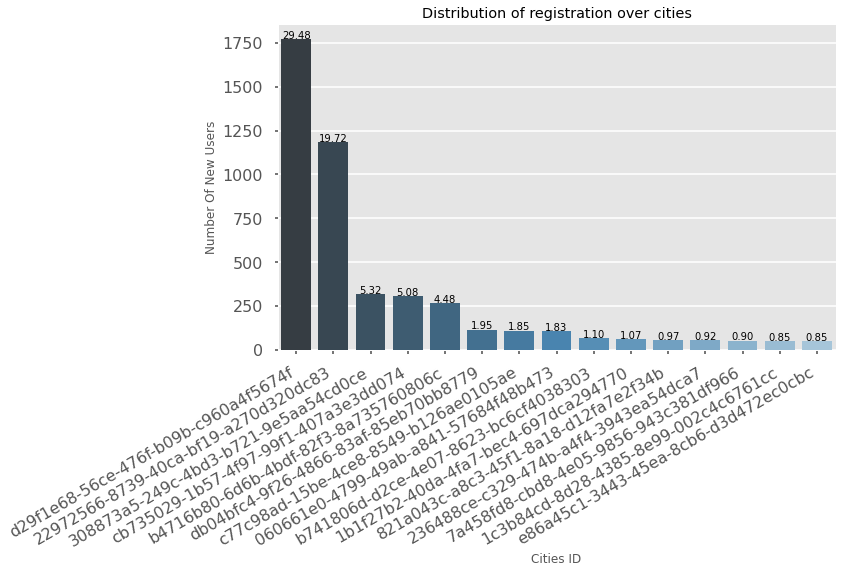

In [13]:
style.use('seaborn-poster') #sets the size of the charts
style.use('ggplot')


fig= plt.figure(figsize=(10,6)) #figsize

ax = sns.barplot(x="city_id", y="Num_users", orient= '90', palette=("Blues_d"), data=cities.head(15))
ax.set_xticklabels(ax.get_xticklabels(),rotation=30, horizontalalignment='right')

# Add title and axis names
plt.title('Distribution Of Registration Over Cities')
plt.xlabel('Cities ID', fontsize='12')
plt.ylabel('Number Of New Users')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}'.format((height/users_df.shape[0])*100),
            ha="center") 

# Save graphic
plt.savefig('Images/Distribution of registration over 15 cities.png',bbox_inches = 'tight')

It can be seen that almost **30%** of our users come from **single** cities. Furthermore, almost a **half** of our users comes from just **two** cities.
Then we have **3** cities with the sum of **15%**, each one almost 5%. The rest cities, are less than **2%** each.

#### User Registration Growth by cities During Period Given 

We other thing that could be interesting to investigate is to find out about user registration growth during this period based on region and cities.

In [14]:
# Make a new dataframe based on date(monthly), cities and number of new users
city_month_count = pd.DataFrame(users_df.groupby([users_df["date"].dt.to_period('M'), users_df.city_uuid])['uuid'].count())

In [15]:
city_month_count.shape

(494, 1)

In [16]:
city_month_count

uuid
date    city_uuid                                 
2017-10 22972566-8739-40ca-bf19-a270d320dc83   184
        22c4976f-4e01-45b9-b05d-0c854e7bd0a0     1
        308873a5-249c-4bd3-b721-9e5aa54cd0ce     5
        4f12d9d2-01ed-4b26-a2f0-b6dc4ae8f398     1
        5796c72a-af37-4ce0-bcfe-9f481ce7ecbe     1
...                                            ...
2018-10 f8599cf8-1268-43d4-9fd9-3df9cdf5963d     1
        f8d0ef97-9f0b-411b-aa9a-69b73a5272e6     8
        f9bedfa1-deaf-41cd-8c06-f6e010a3b487     8
        fb728ded-0321-4a80-b0f5-6ff0ca16bf74     1
        fca5738c-0401-48f1-b446-408fce2a5e98     1

[494 rows x 1 columns]

There are almost 500 cities. That's alot of records! For visualization, It is better to be more specific.

For example, Here I will fillter out cities with less than 10 users per month.

In [17]:
city_month_count = city_month_count[city_month_count['uuid']>=10]

In [18]:
city_month_count.shape

(79, 1)

Still too much! However, it now makes muchm more sense.

In [19]:
# Reset index
city_month_count.reset_index(inplace = True)

In [20]:
# save dates for X axis lable
li_date = city_month_count.date.unique()

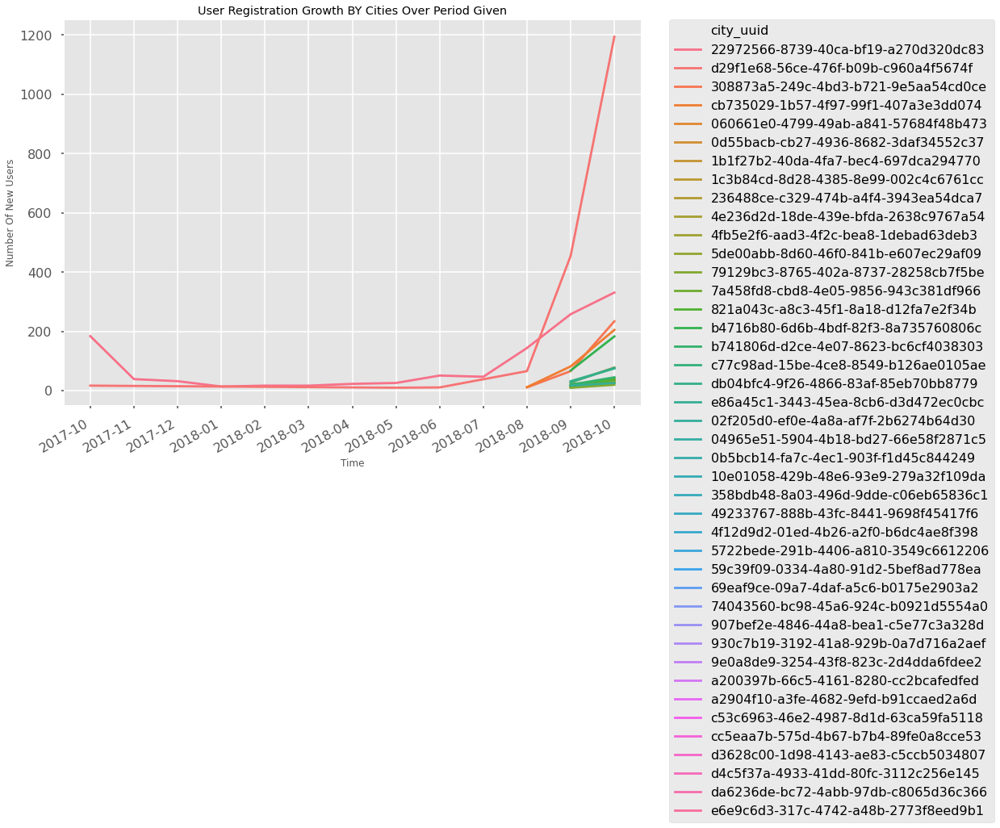

In [21]:
plot = sns.lineplot(x=city_month_count['date'].astype(str), y='uuid', hue='city_uuid', data=city_month_count)


plot.set_xticklabels(li_date,rotation=30, horizontalalignment='right')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)                        # move legend outside the chart

# Add title and axis names
plt.title('User Registration Growth By Cities Over Period Given')
plt.xlabel('Time', fontsize='12')
plt.ylabel('Number Of New Users')


plt.savefig('Images/User Registration Growth BY Cities Over Period Given.png',bbox_inches = 'tight')

To be honest, because of these IDs I cannot suggest anything. However, for example, if we consider two red line as Shiraz and tehran, It is obvious that the number of user registration increase during period shown. Likewise, for other cities we can see an increase in figures from August 2018.

#### Exploring Users Registration based on Month, Day and Hour

Now, We can visualize user regestration Monthly, Daily and hourly in order to develop a sense about when user prefer to sign up in our system.

In [22]:
# Check for date type
users_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6000 entries, 0 to 5999
Data columns (total 4 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   uuid       6000 non-null   object        
 1   city_uuid  6000 non-null   object        
 2   gender     6000 non-null   int64         
 3   date       6000 non-null   datetime64[ns]
dtypes: datetime64[ns](1), int64(1), object(2)
memory usage: 187.6+ KB


#### Month

I begin with monthly registration visualization

In [23]:
# Create a column containing the month
users_df['month'] = pd.to_datetime(users_df['date']).dt.to_period('M')
months = users_df['month'].sort_values()

month = pd.DataFrame(users_df.month.value_counts())
month.reset_index(inplace = True)
month.rename(columns = {'index' : 'Month','month' : 'Count'}, inplace = True)
month.sort_values(by=['Month'], inplace = True, ignore_index=True)
month.head(20)

,Month,Count
0,2017-10,226
1,2017-11,41
2,2017-12,36
3,2018-01,18
4,2018-02,18
5,2018-03,19
6,2018-04,27
7,2018-05,44
8,2018-06,78
9,2018-07,60


We have **226** new users in the frist **month(2017-10)**. Then it can be seen a drop in number of new users registration for **5** month.(There should be a reason for that) and on month 6, again the number of new user registration increased steadily. On **2018-09** the figure for new users registration increased by **1200**, maybe because of some Online marketing campaign or some incentives for new users! 
We have a considerable figure for the last month new user of **3586**.

Now, I illustrate our data to make it more readable.

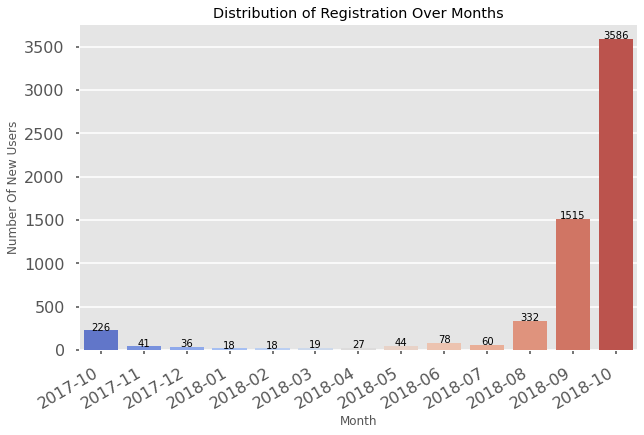

In [24]:
# Monthly distribution count
style.use('seaborn-poster') #sets the size of the charts
style.use('ggplot')

fig= plt.figure(figsize=(10,6))
ax = sns.barplot(x="Month", y="Count", orient= '90',  palette=("coolwarm"), data=month)
ax.set_xticklabels(ax.get_xticklabels(),rotation=30, horizontalalignment='right')

# Add title and axis names
plt.title('Distribution of Registration Over Months')
plt.xlabel('Month', fontsize='12')
plt.ylabel('Number Of New Users')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 

# Show graphic
plt.savefig('Images/Distribution of Registration Over Months.png',bbox_inches = 'tight')

#### Day

I continue with Daily Registration

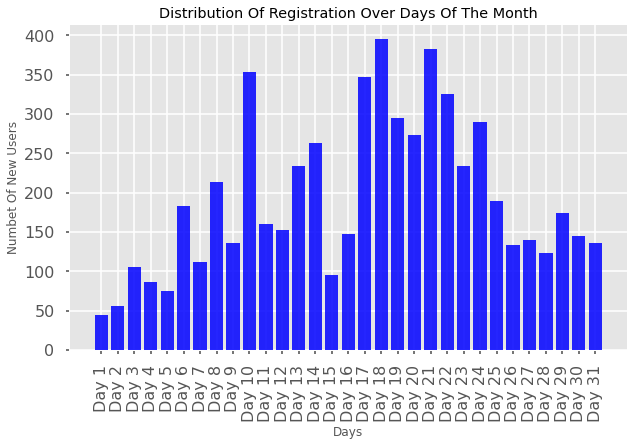

In [25]:
# Daily distribution count
daily_count = users_df.groupby(users_df["date"].dt.day, as_index = False).count()

fig= plt.figure(figsize=(10,6))

# Choose the names of the bars
bars = []
for i in range(1,32):
    bars.append('Day '+str(i))

y_pos = np.arange(len(bars))
 
# Create bars
plt.bar(y_pos, daily_count.date, color = 'Blue', alpha = 0.85)
 
# Create names on the x-axis
plt.xticks(y_pos, bars, rotation=90)
plt.yticks()

# Add title and axis names
plt.title('Distribution Of Registration Over Days Of The Month')
plt.xlabel('Days', fontsize='12')
plt.ylabel('Numbet Of New Users')

 
# Show graphic
plt.savefig('Images/Distribution of new Users Registration over days.png',bbox_inches = 'tight')
plt.show()

From the chart, It seems that people tend to register in third week of a month!

I cannot say why does this happen and it needs alot more data and investigation.

And continue with hourly registration.

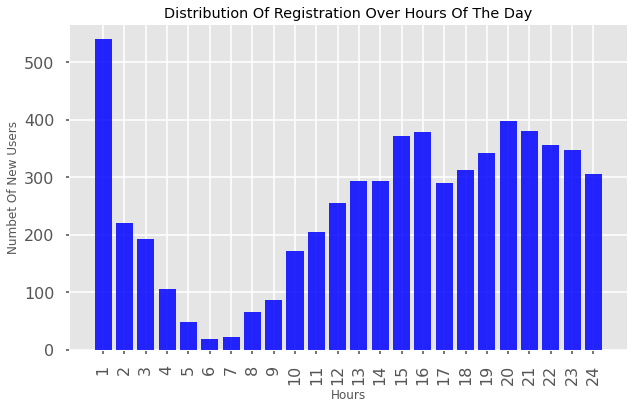

In [26]:
# Hourly distribution count
hourly_count = users_df.groupby(users_df["date"].dt.hour, as_index = False).count()

fig= plt.figure(figsize=(10,6))

# Choose the names of the bars
bars = []
for i in range(1,25):
    bars.append(str(i))

y_pos = np.arange(len(bars))
 
# Create bars
plt.bar(y_pos, hourly_count.date,color = 'Blue', alpha = 0.85)
 
# Create names on the x-axis
plt.xticks(y_pos, bars, rotation=90)
plt.yticks()

# Add title and axis names
plt.title('Distribution Of Registration Over Hours Of The Day')
plt.xlabel('Hours', fontsize='12')
plt.ylabel('Numbet Of New Users')

 
# Show graphic
plt.savefig('Images/Distribution of Registration over hours.png',bbox_inches = 'tight')
plt.show()

It is not a surprise that most of users signed up at night and we have the least user registration during morning.

## Follows DataFrame

#### To Do List
1. Most Active Users
2. Users Network (Directed Network)
3. Community Detection
4. User's Activites over period given

#### Read Data

In [27]:
follows_df = pd.read_csv('komodaa/follows.csv')
follows_df.head()

,user_uuid,follow_uuid,date
0,7effce15-12ba-469c-b4b4-b529425488db,372fe527-470c-48a3-a95e-fe32cc4bcc15,2018-10-05 18:47:56
1,f262a138-9585-4570-9d2d-6815c4d8b6a6,ca28e52f-ad3f-4ad8-8722-4a0fa355cbcd,2020-06-29 14:57:37
2,18566d57-99ea-4f5d-aa23-7769f1b0dcc2,2098ef7a-9215-4d2e-8e95-0ab7e745392f,2019-09-02 08:15:12
3,958029e7-6897-4ae2-be6c-515730568371,498439f1-52ed-4e3d-b07a-fe77061837b5,2018-09-05 05:02:57
4,4afbf6d4-b841-44b1-8f04-eba6e6b102e3,498439f1-52ed-4e3d-b07a-fe77061837b5,2018-09-06 21:59:08


#### Get familiar with data

In [28]:
follows_df.shape

(5886, 3)

In [29]:
# Check for Dublicate
follows_df.duplicated().value_counts()

False    5886
dtype: int64

In [30]:
# Chech for Null Value
missing_percentage = follows_df.isnull().sum() / follows_df.shape[0] * 100
missing_percentage

user_uuid     0.000
follow_uuid   0.000
date          0.000
dtype: float64

In [31]:
print('We have {} distinct followers in our dataset.'.format(follows_df['user_uuid'].nunique()))
print('We have {} distinct followees in our dataset.'.format(follows_df['follow_uuid'].nunique()))

We have 1454 distinct followers in our dataset.
We have 993 distinct followees in our dataset.


#### Most Active Users

I want to find out who are the most active users. Those who follow other users more. It is important to recognize such a user in our data. They are socialable and easy going and as a result are more more open and can spread the words in the network better.

In [32]:
# user who follow the most
active_user=follows_df['user_uuid'].value_counts().to_frame()
active_user.head()

,user_uuid
3cef3fd4-984e-481b-89da-c0692bcc529b,277
7f61564b-4203-4fb6-ac6a-2cc555465ed6,119
e5b4f882-7dca-4e63-a665-f412cb383e39,110
e54cea93-9399-47c1-9c57-be1571252e0a,106
5dda1c4a-8b66-440b-896c-8c0be38645b9,79


In [33]:
print('We have {} users who follow more than 7 other users.'.format(len(active_user[active_user['user_uuid']>7])))
print('We have {} users who follow less than or equal 7 users.'.format(len(active_user[active_user['user_uuid']<=7])))
print('We have {} users who follow exactly one user.'.format(len(active_user[active_user['user_uuid']==1])))

We have 159 users who follow more than 7 other users.
We have 1295 users who follow less than or equal 7 users.
We have 655 users who follow exactly one user.


I consider **7** as a threshold as the [six degrees of separation](https://en.wikipedia.org/wiki/Six_degrees_of_separation) theory states that any inhabitant of the Earth could meet anyone in the world with a maximum of six or fewer mutual connections between them and another person.


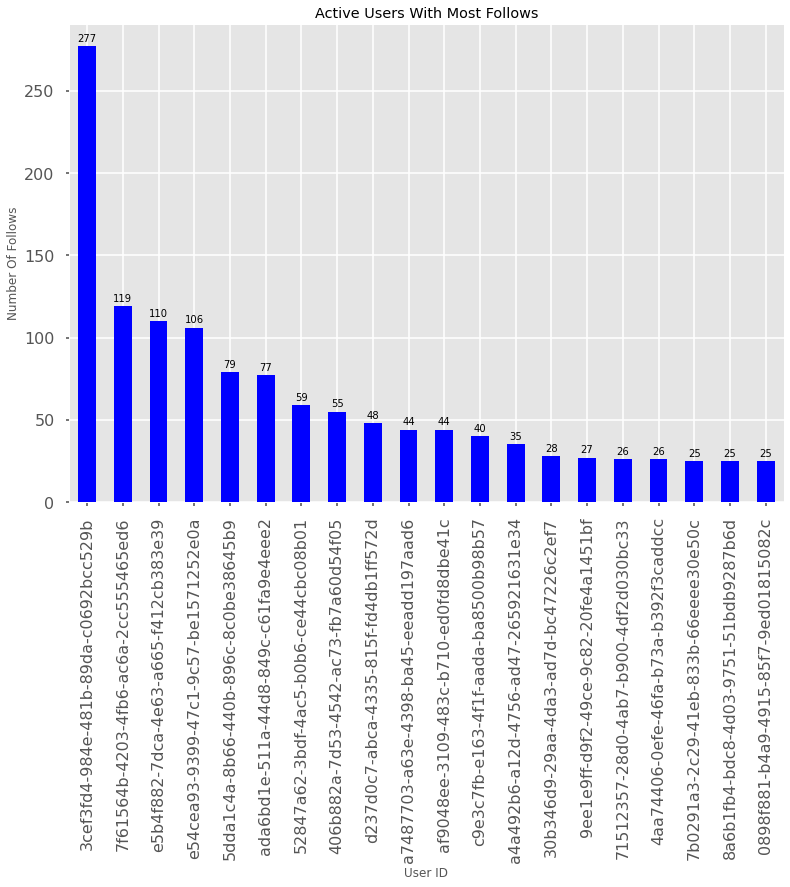

In [34]:
ax = active_user.head(20).plot(kind = 'bar', color = 'b', legend = False)


#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 

# Add title and axis names
plt.title('Active Users With Most Follows')
plt.xlabel('User ID', fontsize='12')
plt.ylabel('Number Of Follows')

 
# Show graphic
plt.savefig('Images/Active Users with most follows.png',bbox_inches = 'tight')
plt.show()

#### Most popular user

In [35]:
# user who is followed the most
popular_user = follows_df['follow_uuid'].value_counts().to_frame()
popular_user.head()

,follow_uuid
233255de-55b8-4a46-800f-172a58016eec,263
17fc2fcd-55d4-4342-a553-302e56d6d816,205
1ed79a26-26f7-4ce9-a711-a4fe0ea5e285,165
3cef3fd4-984e-481b-89da-c0692bcc529b,153
cc998035-b8c6-40bf-b9c9-0edb04b73af7,151


In [36]:
print('We have {} users who are followed by more than 7 other users.'.format(len(popular_user[popular_user['follow_uuid']>7])))
print('We have {} users who are followed by less than or equal 7 users.'.format(len(popular_user[popular_user['follow_uuid']<=7])))
print('We have {} users who are followed by exactly one user.'.format(len(popular_user[popular_user['follow_uuid']==1])))

We have 126 users who are followed by more than 7 other users.
We have 867 users who are followed by less than or equal 7 users.
We have 528 users who are followed by exactly one user.


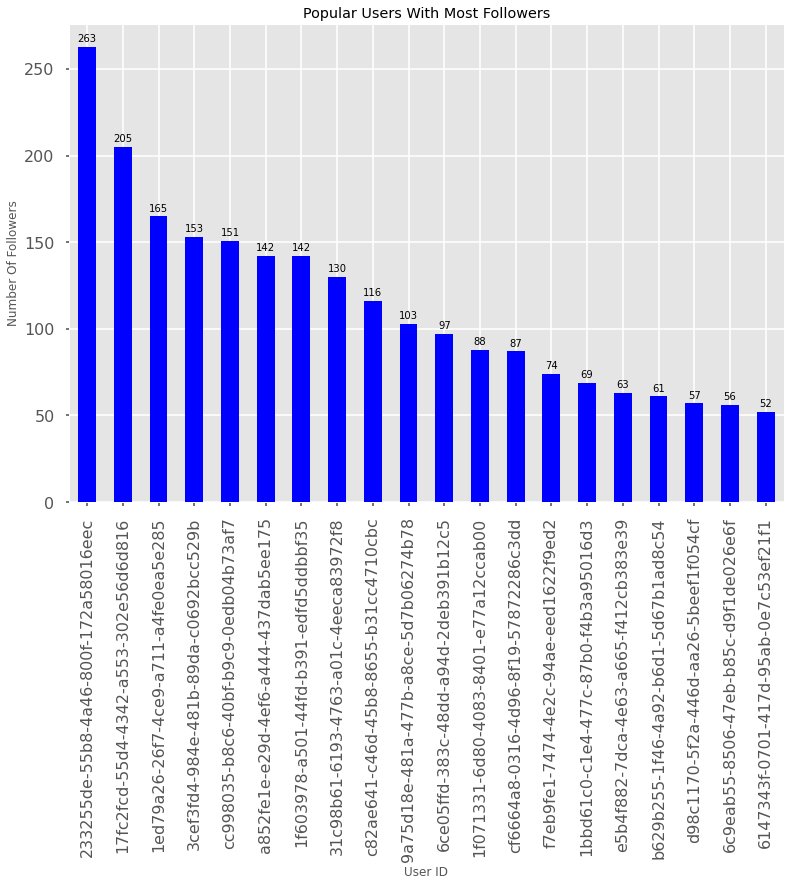

In [37]:
ax = popular_user.head(20).plot(kind = 'bar', color = 'b', legend = False)

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
# Add title and axis names
plt.title('Popular Users With Most Followers')
plt.xlabel('User ID', fontsize='12')
plt.ylabel('Number Of Followers')

 
# Show graphic
plt.savefig('Images/popular Users with most followers.png',bbox_inches = 'tight')
plt.show()

#### Users Network (Directed Network)

In [38]:
follows_df.head(2)

,user_uuid,follow_uuid,date
0,7effce15-12ba-469c-b4b4-b529425488db,372fe527-470c-48a3-a95e-fe32cc4bcc15,2018-10-05 18:47:56
1,f262a138-9585-4570-9d2d-6815c4d8b6a6,ca28e52f-ad3f-4ad8-8722-4a0fa355cbcd,2020-06-29 14:57:37


The first step is to extract nodes and edges from the dataframe

In [39]:
# spacify node's names
nodes = follows_df.user_uuid.unique().tolist()
nodes[:10]

['7effce15-12ba-469c-b4b4-b529425488db',
 'f262a138-9585-4570-9d2d-6815c4d8b6a6',
 '18566d57-99ea-4f5d-aa23-7769f1b0dcc2',
 '958029e7-6897-4ae2-be6c-515730568371',
 '4afbf6d4-b841-44b1-8f04-eba6e6b102e3',
 '8e7730ec-96b4-4730-820d-9b8b64f7834f',
 '763930ba-0d7f-46dd-8e76-1fe3f18aba17',
 '19cc4b3b-7a64-441d-8e90-c68f9ceb6022',
 '41730565-9335-4b37-9f74-d167a63d7a00',
 'ce1b7a97-e6ac-4e2c-9251-9e69e7331276']

In [40]:
# spacify edges
edges = list(zip(follows_df.user_uuid, follows_df.follow_uuid))
edges[:10]

[('7effce15-12ba-469c-b4b4-b529425488db',
  '372fe527-470c-48a3-a95e-fe32cc4bcc15'),
 ('f262a138-9585-4570-9d2d-6815c4d8b6a6',
  'ca28e52f-ad3f-4ad8-8722-4a0fa355cbcd'),
 ('18566d57-99ea-4f5d-aa23-7769f1b0dcc2',
  '2098ef7a-9215-4d2e-8e95-0ab7e745392f'),
 ('958029e7-6897-4ae2-be6c-515730568371',
  '498439f1-52ed-4e3d-b07a-fe77061837b5'),
 ('4afbf6d4-b841-44b1-8f04-eba6e6b102e3',
  '498439f1-52ed-4e3d-b07a-fe77061837b5'),
 ('8e7730ec-96b4-4730-820d-9b8b64f7834f',
  '498439f1-52ed-4e3d-b07a-fe77061837b5'),
 ('763930ba-0d7f-46dd-8e76-1fe3f18aba17',
  '498439f1-52ed-4e3d-b07a-fe77061837b5'),
 ('19cc4b3b-7a64-441d-8e90-c68f9ceb6022',
  '498439f1-52ed-4e3d-b07a-fe77061837b5'),
 ('41730565-9335-4b37-9f74-d167a63d7a00',
  '498439f1-52ed-4e3d-b07a-fe77061837b5'),
 ('ce1b7a97-e6ac-4e2c-9251-9e69e7331276',
  '8f237e9d-52c7-4ec8-ae23-6898070ba539')]

In [41]:
G = nx.DiGraph()
G.add_nodes_from(nodes)
G.add_edges_from(edges)

In [42]:
print(nx.info(G))

Name: 
Type: DiGraph
Number of nodes: 1799
Number of edges: 5886
Average in degree:   3.2718
Average out degree:   3.2718


**Why visualize a graph at all?**

Usually, we simply have a set of vertices and edges as input. We can compute some statistics or graph metrics based on such data, but it is not enough to get an idea of structure. A good visualization can clearly show if there are some clusters or bridges in a graph, or maybe it is a uniform cloud, or something else.

**Problems?**
Commonly, the visualization of a large graph looks messy because there are too many objects in one plot. Also, graph visualization algorithms mostly have awful algorithmic complexity

**Layout**
Layout is a way to map a coordinate to each vertex. Usually, this is coordinates on a 2D plane.
**What is a good layout?**
It is easy to say if something looks good or bad. It is not so easy to name criteria, how could machine evaluate it. In order to make a “good” layout so-called, aesthetic metrics can be used. Here is some of them:
1. Minimum edges intersection
    It is obvious: too many intersections make the plot look messy.
2. Adjacent vertices are closer to each other than not adjacent
    This is logical that connected nodes should be close to each other. It represents the main information that is present in a graph by definition.
3. Communities are grouped into clusters
    If there are a set of vertices that are connected to each other more frequent then to other parts of the graph, they should look like a dense cloud.
4. Minimum overlapping edges and nodes.
    It is obvious too: if we cannot determine if there few vertices or one, then the readability of plot is poor.
    
There are plenty of different tools for Large Graph Visualization. However, despite graph visualization problem is relatively old and popular, there is a very bad situation with tools that can handle large graphs.
- GraphViz
- Gephi, the most powerful graph visualization tool that I know. It has GUI, it contains several layouts and a lot of graph analysis tools. There is also a lot of plugins written by the community. For example my favorite layout “Multigravity Force-Atlas 2” or sigma.js export tool, which creates an interactive web-page template based on your project. In Gephi users can color nodes and edges by its features. Although Gephi is abandoned by developers, for the this project I decided to use it for visualization.
- igraph
- LargeViz
- Graph Embeddings
and many others

**Graph Theory**

A good metric to begin with is network **density**. 

This is simply the ratio of actual edges in the network to all possible edges in the network. Network density gives us a quick sense of how closely knit the network is.

In [43]:
density = nx.density(G)
degree_centrality = nx.algorithms.degree_centrality(G)
print("Network Density:", density)

Network Density: 0.0018196983740194311


In this case, the density of our network is approximately **0.0018** On a scale of 0 to 1, not a very dense network, which comports with the visualization. 
A 0 would mean that there are no connections at all, and a 1 would indicate that all possible edges are present (a perfectly connected network): this network is on the lower end of that scale, but still far from 0.

Next is the **Graph Diameter**, it is a graph distance. In other words, a graph's diameter is the largest number of vertices which must be traversed in order to travel from one vertex to another when paths which backtrack, detour, or loop are excluded from consideration. 
Diameter, is the longest of all shortest paths. After calculating all shortest paths between every possible pair of nodes in the network, diameter is the length of the path between the two nodes that are furthest apart. 
The measure is designed to give us a sense of the network’s overall size, the distance from one end of the network to another.
However, it needs the graph to be fully connected and running this command on the Komodaa graph will yield an error telling the Graph is “not connected.”

In [44]:
# chech if the graph is fully connected then calculate the diameter
if nx.is_strongly_connected(G):
    nx.diameter(G)
else:
    print('The graph is not fully connected and has more than one component.')

The graph is not fully connected and has more than one component.


Instead we can calculate the diameter for the largest component of the Graph

In [45]:
# Use nx.connected_components(undirected)/nx.strongly_connected_components(directed) to get the list of components
components = nx.strongly_connected_components(G)

# Use the max() command to find the largest one
largest_component = max(components, key=len)

subgraph = G.subgraph(largest_component)
diameter = nx.diameter(subgraph)
print("Network diameter of largest component:", diameter)

Network diameter of largest component: 11


Since we took the largest component, we can assume there is no larger diameter for the other components. Therefore this figure is a good stand in for the diameter of the whole Graph.

In [46]:
nx.average_degree_connectivity(G) # For a node of degree k - What is the average of its neighbours' degree?

{18: 42.49444444444445,
 5: 70.27466666666666,
 4: 61.98790322580645,
 8: 58.994140625,
 21: 43.92063492063492,
 3: 72.03298611111111,
 24: 31.7,
 32: 20.0,
 37: 28.905405405405407,
 14: 37.38690476190476,
 2: 60.75800711743772,
 10: 60.48695652173913,
 16: 37.125,
 7: 61.839285714285715,
 1: 64.45035971223021,
 6: 60.634408602150536,
 13: 53.84102564102564,
 101: 22.742574257425744,
 11: 60.93560606060606,
 116: 27.310344827586206,
 26: 45.88461538461539,
 120: 30.55,
 17: 51.3235294117647,
 27: 21.83703703703704,
 25: 35.586666666666666,
 52: 20.798076923076923,
 9: 43.550925925925924,
 61: 9.87704918032787,
 41: 18.317073170731707,
 117: 2.247863247863248,
 30: 36.2047619047619,
 96: 7.953125,
 15: 51.36,
 49: 3.663265306122449,
 22: 46.21590909090909,
 36: 22.90740740740741,
 23: 49.07608695652174,
 51: 11.235294117647058,
 20: 51.075,
 153: 6.509803921568627,
 12: 56.37820512820513,
 19: 39.06578947368421,
 430: 7.402325581395349,
 39: 41.06410256410256,
 71: 6.140845070422535,
 5

The final structural calculation is **triadic closure**. 
Triadic closure supposes that if two people know the same person, they are likely to know each other. 
If Fox knows both Wolf and Lion, then Wolf and Lion may very well know each other, completing a triangle in the visualization of three edges connecting Fox, Wolf, and Lion. 
The number of these enclosed triangles in the network can be used to find clusters and communities of individuals that all know each other fairly well.

One way of measuring triadic closure is called transitivity. Transitivity is the ratio of all triangles over all possible triangles. A possible triangle exists when one person (Fox) knows two people (Wolf and Lion). So transitivity, like density, expresses how interconnected a graph is in terms of a ratio of actual over possible connections. 

<blockquote>Measurements like transitivity and density concern likelihoods rather than certainties. Transitivity allows us a way of thinking about all the relationships in your graph that may exist but currently do not.</blockquote >

In [47]:
triadic_closure = nx.transitivity(G)
print("Triadic closure:", triadic_closure)

Triadic closure: 0.026756633640815396


like density, transitivity is scaled from 0 to 1, and you can see that the network’s transitivity is about **0.0267**, somewhat higher than its **0.0018** density. Because the graph is not very dense, there are fewer possible triangles to begin with, which may result in slightly higher transitivity. That is, nodes that already have lots of connections are likely to be part of these enclosed triangles. To back this up, you’ll want to know more about nodes with many connections.

After getting some basic measures of the entire network structure, a good next step is to find which nodes are the most important ones in your network. 

**In network analysis, measures of the importance of nodes are referred to as centrality measures.`**

**Degree** is the simplest and the most common way of finding important nodes. A node’s degree is the sum of its edges. If a node has three lines extending from it to other nodes, its degree is three. Five edges, its degree is five. 

The nodes with the highest degree in a social network are the people who know the most people. These nodes are often referred to as hubs, and calculating degree is the quickest way of identifying hubs.

In [48]:
degree_dict = dict(G.degree(G.nodes()))
nx.set_node_attributes(G, degree_dict, 'degree')

In [49]:
sorted_degree = sorted(degree_dict.items(), key=itemgetter(1), reverse=True)

In [50]:
print("Top 20 nodes by degree:")
for d in sorted_degree[:20]:
    print(d)

Top 20 nodes by degree:
('3cef3fd4-984e-481b-89da-c0692bcc529b', 430)
('233255de-55b8-4a46-800f-172a58016eec', 263)
('17fc2fcd-55d4-4342-a553-302e56d6d816', 210)
('e5b4f882-7dca-4e63-a665-f412cb383e39', 173)
('1ed79a26-26f7-4ce9-a711-a4fe0ea5e285', 168)
('a852fe1e-e29d-4ef6-a444-437dab5ee175', 153)
('cc998035-b8c6-40bf-b9c9-0edb04b73af7', 152)
('1f603978-a501-44fd-b391-edfd5ddbbf35', 142)
('31c98b61-6193-4763-a01c-4eeca83972f8', 131)
('7f61564b-4203-4fb6-ac6a-2cc555465ed6', 120)
('c82ae641-c46d-45b8-8655-b31cc4710cbc', 117)
('e54cea93-9399-47c1-9c57-be1571252e0a', 116)
('9a75d18e-481a-477b-a8ce-5d7b06274b78', 103)
('ada6bd1e-511a-44d8-849c-c61fa9e4eee2', 101)
('6ce05ffd-383c-48dd-a94d-2deb391b12c5', 100)
('cf6664a8-0316-4d96-8f19-57872286c3dd', 96)
('1f071331-6d80-4083-8401-e77a12ccab00', 96)
('5dda1c4a-8b66-440b-896c-8c0be38645b9', 85)
('f7eb9fe1-7474-4e2c-94ae-eed1622f9ed2', 78)
('6c9eab55-8506-47eb-b85c-d9f1de026e6f', 74)


There are other centrality measures that can tell you about more than just hubs. **Eigenvector centrality** is a kind of extension of degree. It looks at a combination of a node’s edges and the edges of that node’s neighbors. Eigenvector centrality cares if you are a hub, but it also cares how many hubs you are connected to. 

It’s calculated as a value from 0 to 1: the closer to one, the greater the centrality. Eigenvector centrality is useful for understanding which nodes can get information to many other nodes quickly. If you know a lot of well-connected people, you could spread a message very efficiently. 

**Betweenness centrality** is a bit different from the other two measures in that it doesn’t care about the number of edges any one node or set of nodes has. Betweenness centrality looks at all the shortest paths that pass through a particular node. Betweenness centrality is also expressed on a scale of 0 to 1 and is fairly good at finding nodes that connect two otherwise disparate parts of a network. If you’re the only thing connecting two clusters, every communication between those clusters has to pass through you. In contrast to a hub, this sort of node is often referred to as a broker. Betweenness centrality is not the only way of finding brokerage (and other methods are more systematic), but it’s a quick way of giving you a sense of which nodes are important not because they have lots of connections themselves but because they stand between groups, giving the network connectivity and cohesion.

In [51]:
betweenness_dict = nx.betweenness_centrality(G) # Run betweenness centrality
eigenvector_dict = nx.eigenvector_centrality(G) # Run eigenvector centrality

# Assign each to an attribute in your network
nx.set_node_attributes(G, betweenness_dict, 'betweenness')
nx.set_node_attributes(G, eigenvector_dict, 'eigenvector')

In [52]:
sorted_eigenvector = sorted(eigenvector_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by eigenvector centrality:")
for b in sorted_eigenvector[:20]:
    print(b)

Top 20 nodes by eigenvector centrality:
('233255de-55b8-4a46-800f-172a58016eec', 0.33266079736633003)
('17fc2fcd-55d4-4342-a553-302e56d6d816', 0.32067296193815653)
('1f603978-a501-44fd-b391-edfd5ddbbf35', 0.2599995488674807)
('3cef3fd4-984e-481b-89da-c0692bcc529b', 0.2540671320258265)
('a852fe1e-e29d-4ef6-a444-437dab5ee175', 0.22852299905172455)
('cc998035-b8c6-40bf-b9c9-0edb04b73af7', 0.19504616539726835)
('31c98b61-6193-4763-a01c-4eeca83972f8', 0.1564087282150767)
('1f071331-6d80-4083-8401-e77a12ccab00', 0.15080839217447564)
('c82ae641-c46d-45b8-8655-b31cc4710cbc', 0.1463700015770921)
('1ed79a26-26f7-4ce9-a711-a4fe0ea5e285', 0.13608870045734683)
('f7eb9fe1-7474-4e2c-94ae-eed1622f9ed2', 0.13485112050812012)
('cf6664a8-0316-4d96-8f19-57872286c3dd', 0.13306877329977343)
('6ce05ffd-383c-48dd-a94d-2deb391b12c5', 0.13161623769776556)
('1bbd61c0-c1e4-477c-87b0-f4b3a95016d3', 0.11568972379164869)
('9a75d18e-481a-477b-a8ce-5d7b06274b78', 0.11542285028885722)
('8d853d53-dff3-4c64-998a-fcb6846f

In [53]:
sorted_betweenness = sorted(betweenness_dict.items(), key=itemgetter(1), reverse=True)

print("Top 20 nodes by betweenness centrality:")
for b in sorted_betweenness[:20]:
    print(b)

Top 20 nodes by betweenness centrality:
('3cef3fd4-984e-481b-89da-c0692bcc529b', 0.17181568706495995)
('1f071331-6d80-4083-8401-e77a12ccab00', 0.061100219607097744)
('17fc2fcd-55d4-4342-a553-302e56d6d816', 0.041879041479161924)
('e5b4f882-7dca-4e63-a665-f412cb383e39', 0.038061797844850254)
('cf6664a8-0316-4d96-8f19-57872286c3dd', 0.02958144828013708)
('b8e9c4e8-6821-47af-88df-afbdb232a935', 0.023323905546090085)
('a7487703-a63e-4398-ba45-eeadd197aad6', 0.021356548440168835)
('91674087-2b1b-4fe1-8569-ad6207922522', 0.015288483872622683)
('1bbd61c0-c1e4-477c-87b0-f4b3a95016d3', 0.015155226342864477)
('ada6bd1e-511a-44d8-849c-c61fa9e4eee2', 0.014369080930366162)
('a852fe1e-e29d-4ef6-a444-437dab5ee175', 0.013598259220916547)
('e54cea93-9399-47c1-9c57-be1571252e0a', 0.013264513693908228)
('f8fe6f0a-cefd-4ced-b08f-914c6fc0c29b', 0.013259923459299902)
('61c3b4b1-e33a-47d6-b62a-3dd2c78e4497', 0.012268990999026199)
('31c98b61-6193-4763-a01c-4eeca83972f8', 0.012125831363723687)
('6ce05ffd-383c-4

Many, but not all, of the nodes that have high degree also have high betweenness centrality.

In [54]:
#First get the top 20 nodes by betweenness as a list
top_betweenness = sorted_betweenness[:20]

#Then find and print their degree
for tb in top_betweenness: # Loop through top_betweenness
    degree = degree_dict[tb[0]] # Use degree_dict to access a node's degree, see footnote 2
    print("Name:", tb[0], "| Betweenness Centrality:", tb[1], "| Degree:", degree)

Name: 3cef3fd4-984e-481b-89da-c0692bcc529b | Betweenness Centrality: 0.17181568706495995 | Degree: 430
Name: 1f071331-6d80-4083-8401-e77a12ccab00 | Betweenness Centrality: 0.061100219607097744 | Degree: 96
Name: 17fc2fcd-55d4-4342-a553-302e56d6d816 | Betweenness Centrality: 0.041879041479161924 | Degree: 210
Name: e5b4f882-7dca-4e63-a665-f412cb383e39 | Betweenness Centrality: 0.038061797844850254 | Degree: 173
Name: cf6664a8-0316-4d96-8f19-57872286c3dd | Betweenness Centrality: 0.02958144828013708 | Degree: 96
Name: b8e9c4e8-6821-47af-88df-afbdb232a935 | Betweenness Centrality: 0.023323905546090085 | Degree: 39
Name: a7487703-a63e-4398-ba45-eeadd197aad6 | Betweenness Centrality: 0.021356548440168835 | Degree: 60
Name: 91674087-2b1b-4fe1-8569-ad6207922522 | Betweenness Centrality: 0.015288483872622683 | Degree: 39
Name: 1bbd61c0-c1e4-477c-87b0-f4b3a95016d3 | Betweenness Centrality: 0.015155226342864477 | Degree: 71
Name: ada6bd1e-511a-44d8-849c-c61fa9e4eee2 | Betweenness Centrality: 0.0

#### Community detection with modularity

Is our network one big, happy family where everyone knows everyone else? Or is it a collection of smaller subgroups that are only connected by one or two intermediaries? 

A community has high density relative to other nodes within its module but low density with those outside. 


In [55]:
H = nx.Graph(G)
communities = list(community.greedy_modularity_communities(H))

In [56]:
modularity_dict = {}                                    # Create a blank dictionary
for i,c in enumerate(communities):                      # Loop through the list of communities, keeping track of the number for the community
    for name in c:                                      # Loop through each person in a community
        modularity_dict[name] = i                       # Create an entry in the dictionary for the person, where the value is which group they belong to.

# Add modularity information
nx.set_node_attributes(G, modularity_dict, 'modularity')

In [57]:
# First get a list of just the nodes in that class
class0 = [n for n in G.nodes() if G.nodes[n]['modularity'] == 0]

# Then create a dictionary of the eigenvector centralities of those nodes
class0_eigenvector = {n:G.nodes[n]['eigenvector'] for n in class0}

# Then sort that dictionary and print the first 5 results
class0_sorted_by_eigenvector = sorted(class0_eigenvector.items(), key=itemgetter(1), reverse=True)

print("Modularity Class 0 Sorted by Eigenvector Centrality:")
for node in class0_sorted_by_eigenvector[:5]:
    print("Name:", node[0], "| Eigenvector Centrality:", node[1])

Modularity Class 0 Sorted by Eigenvector Centrality:
Name: 233255de-55b8-4a46-800f-172a58016eec | Eigenvector Centrality: 0.33266079736633003
Name: c82ae641-c46d-45b8-8655-b31cc4710cbc | Eigenvector Centrality: 0.1463700015770921
Name: f7eb9fe1-7474-4e2c-94ae-eed1622f9ed2 | Eigenvector Centrality: 0.13485112050812012
Name: cf6664a8-0316-4d96-8f19-57872286c3dd | Eigenvector Centrality: 0.13306877329977343
Name: b5f81ad9-ca01-4728-8a0c-c14f0edf3e66 | Eigenvector Centrality: 0.08582988577514133


Using eigenvector centrality as a ranking can give a sense of the important people within this modularity class. 

In [58]:
for i,c in enumerate(communities):                               # Loop through the list of communities
    if len(c) > 2:                                               # Filter out modularity classes with 2 or fewer nodes
        print('Class '+str(i)+':','\n', list(c), '\n')                      # Print out the classes and their members

Class 0: 
 ['4cd14ded-6376-4251-8244-3055914be497', '07e72109-d983-4d7f-9adf-befe2f33bd41', '4b4e8392-6598-4523-b5ea-86fe1e9d62c1', '8bd54eaa-82a7-40a6-b1fc-76c599201264', '29493aea-00cc-4a8e-83b9-4ec9c87ebe44', 'a2607f08-a0ad-4972-8c18-05ac05e42103', '9f2f64e5-8afc-4518-9607-ffccb0020f97', '0f11c9fc-10b8-4b6e-99fc-5c775a7940ea', 'cee3fea4-2237-4597-8e82-4327a5cfd5f3', 'cf6664a8-0316-4d96-8f19-57872286c3dd', '63b737d0-1d21-46d6-ac9d-1f63bf74bb72', 'c823cdf4-324e-4afd-b8be-526afdbaf0bc', 'b0eddeb6-0418-4bc4-918c-56caa0cf288d', 'f9b535b7-98e5-48bf-b467-bb9d2f2bc9c0', '8c942c58-9029-4edf-851e-642327d6cf8c', '5bcfe486-512f-442f-b15c-a4494aec181c', '1475728d-dbb5-4bc0-af7f-d84ed76d29cd', '94b23a7a-d191-47a7-b462-5cf36185ce91', '06fb04b4-2790-4ae2-84d4-2b3c754a119b', '0e6d45b5-978b-4a14-95e3-8e7c59d74b79', 'aa0d299c-92b4-46ac-a778-141e12ffa5dc', 'd1df4da4-f9ce-48d2-b483-76a0db2c7a0b', '949543ad-ee51-4cd2-abd7-f97933b77e01', '49d246fe-e634-4202-bd73-39bbac8d39a8', 'bcb42d91-bcc2-41c7-b518-d24

I filtering out any modularity classes with two or fewer nodes, in the line ``` if len(c) > 2 ```. Remember from the visualization that there were lots of small components of the network with only two nodes. Modularity will find these components and treat them as separate classes (since they’re not connected to anything else). By filtering them out, we get a better sense of the larger modularity classes within the network’s main component.

In [59]:
# export  data into Gephi’s GEXF format for visualization
nx.write_gexf(G, 'follow_network.gexf')

### Visualization Graph using python networkx

#### Make graph from G from previous step

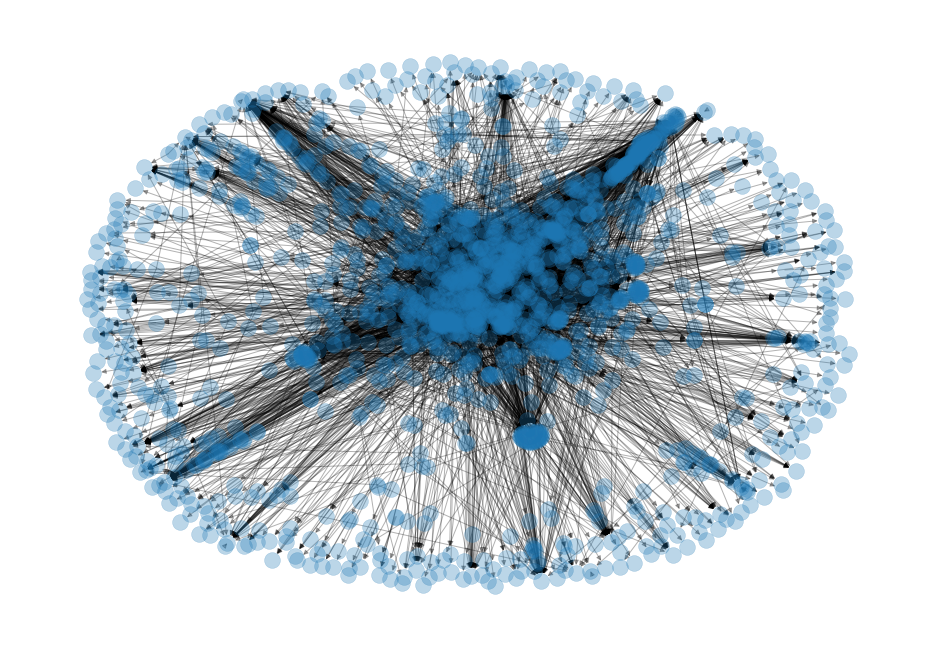

In [60]:
nx.draw(G, with_labels=False, node_size=250, alpha=0.3, arrows=True, font_weight='bold')

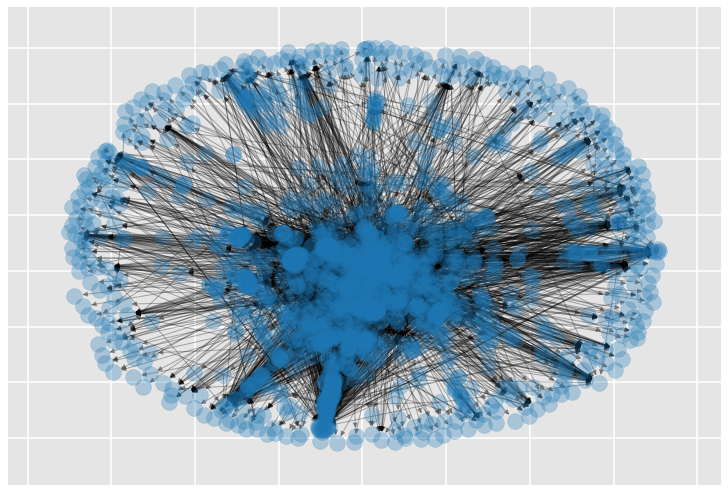

In [61]:
nx.draw_networkx(G, with_labels=False, node_size=250, alpha=0.3, arrows=True, font_weight='bold')

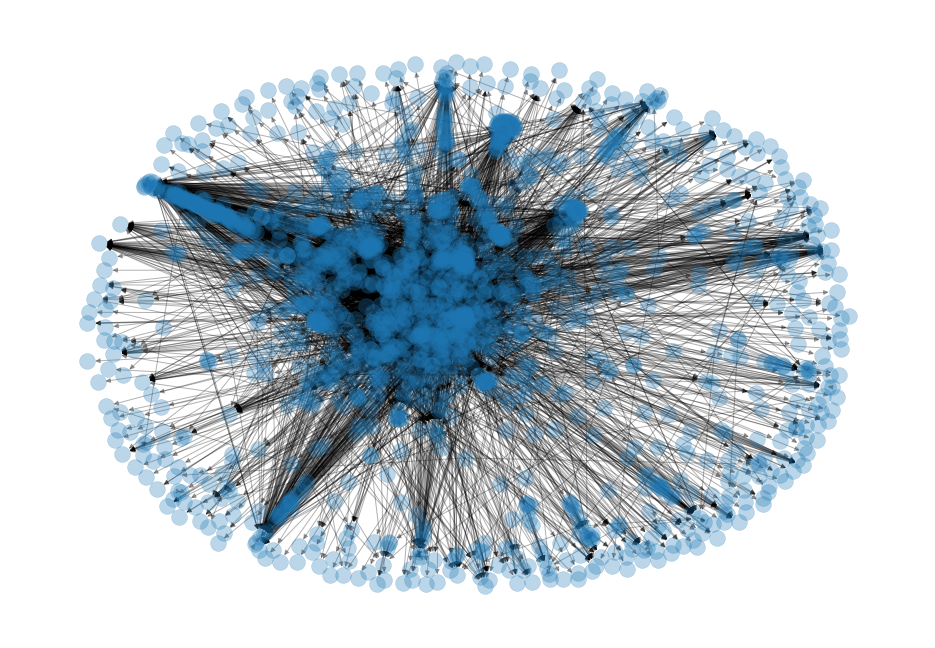

In [62]:
nx.draw_spring(G, with_labels=False, node_size=250, alpha=0.3, arrows=True, font_weight='bold')

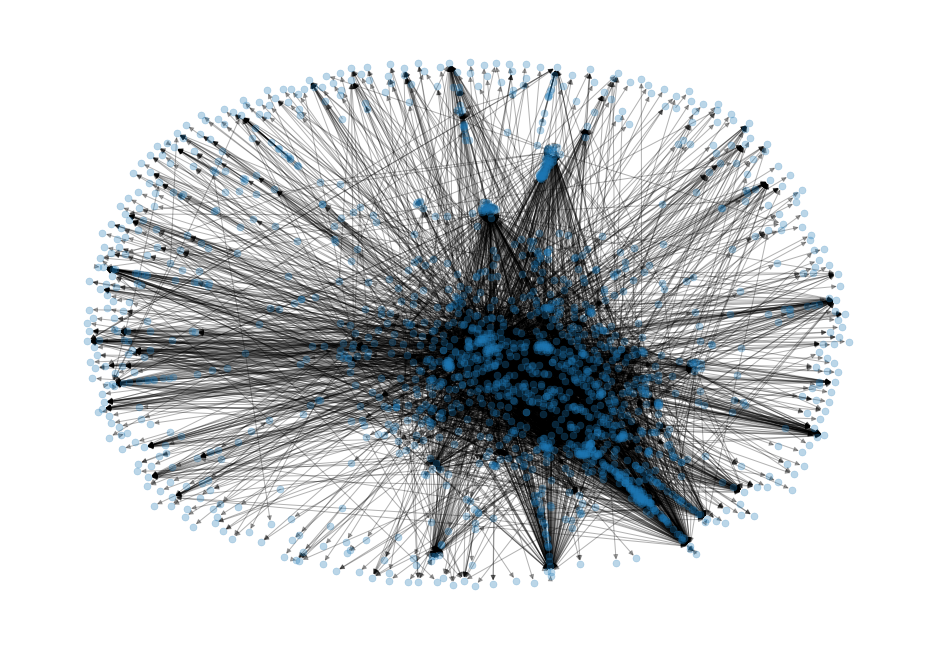

In [63]:
pos = nx.spring_layout(G, k=15)
nx.draw_spring(G, with_labels=False, node_size=50, alpha=0.3, arrows=True, font_weight='bold')

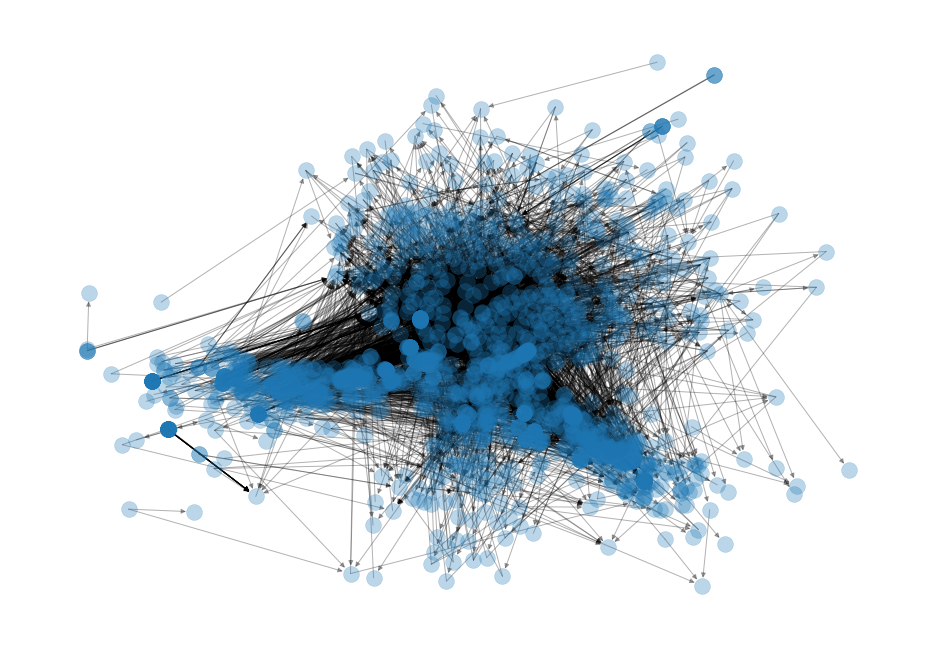

In [64]:
nx.draw_kamada_kawai(G, with_labels=False, node_size=250, alpha=0.3, arrows=True, font_weight='bold')

let's plot the giant connected component ( GCC ) instead
Connected component in a directed graph:

1. Strongly connected components:

     There is a directed path between node A to node B and another from node B to node A.

2. Weakly connected components:

    There is a directed path from node A to node B but not necessarily from node B to node A

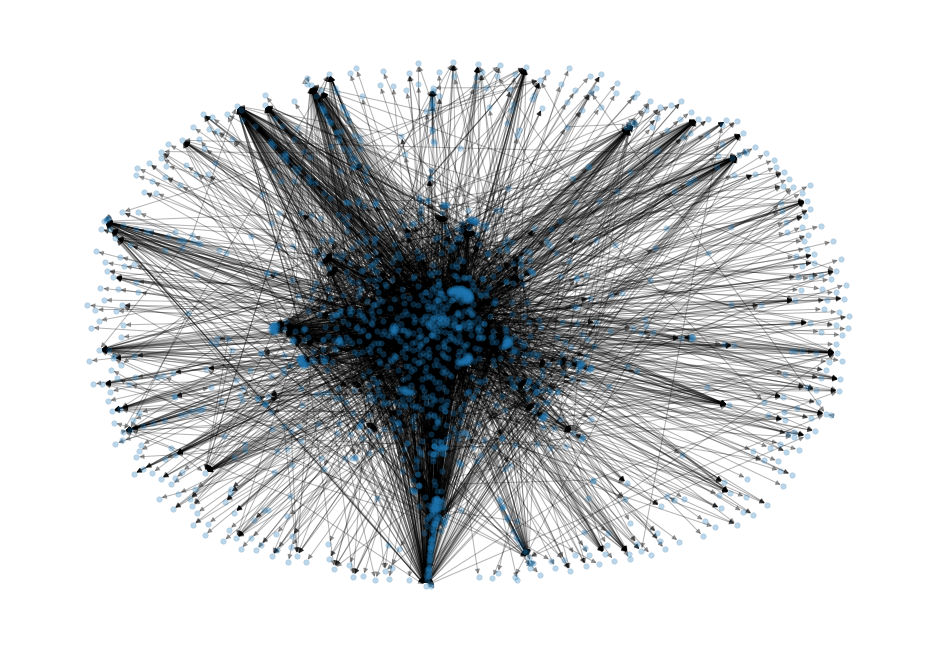

In [65]:
gcc = max(nx.weakly_connected_components(G), key=lambda x: len(x))
H = G.subgraph(gcc)
pos = nx.spring_layout(G, k=5)
nx.draw_spring(H, with_labels=False, node_size=30 , alpha=0.3, arrows=True)

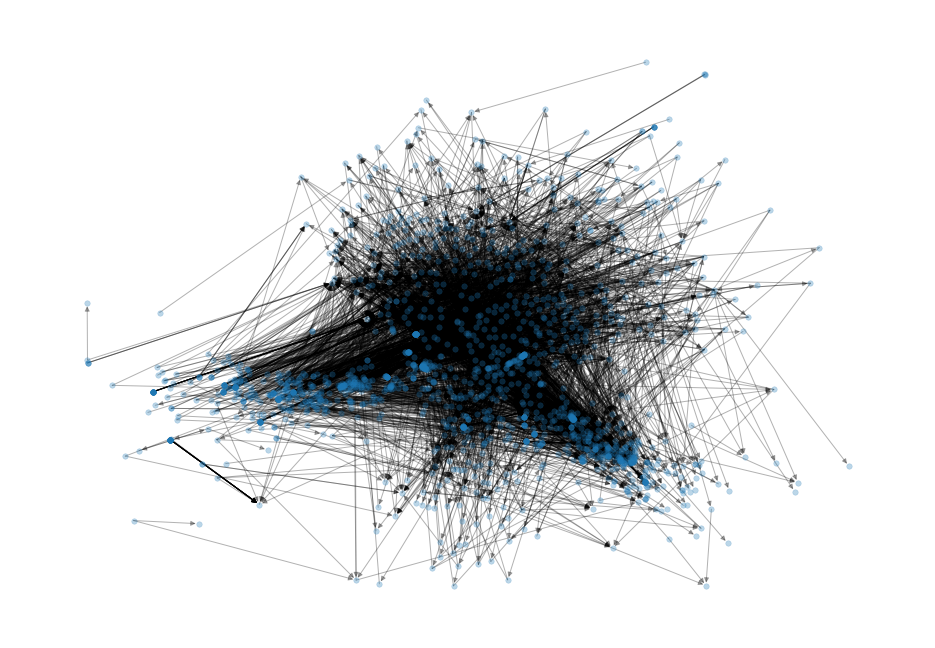

In [66]:
nx.draw_kamada_kawai(H, with_labels=False, node_size=30, alpha=0.3, arrows=True)

#### Make from Pandas DF

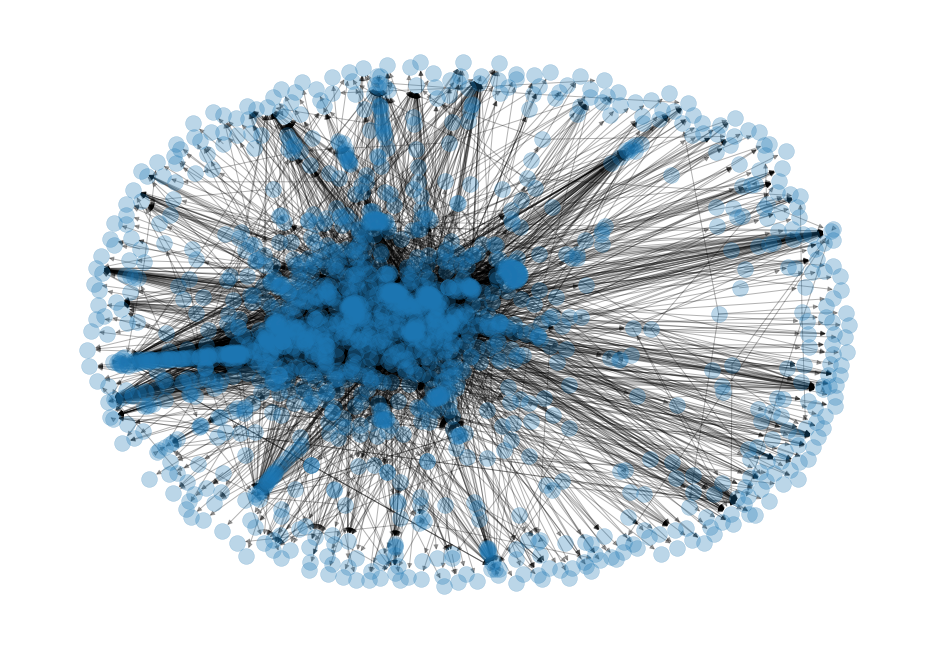

In [67]:
#DIRECTED
G=nx.from_pandas_edgelist(follows_df, source='user_uuid', target='follow_uuid', create_using=nx.DiGraph() )
 
# Make the graph
nx.draw(G, with_labels=False, node_size=250, alpha=0.3, arrows=True)


#### Interactive graph

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
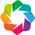

In [68]:
import holoviews as hv
from holoviews import opts

hv.extension('bokeh')

defaults = dict(width=1000, height=1000)
hv.opts.defaults(opts.EdgePaths(**defaults), opts.Graph(**defaults), opts.Nodes(**defaults))

In [69]:
source = follows_df['user_uuid']
target = follows_df['follow_uuid']
simple_graph = hv.Graph(((source, target),))
simple_graph.relabel('Directed Graph').opts(directed=True, node_size=10, arrowhead_length=0.03)

:Graph   [start,end]

In [70]:
# from_nx_graph= hv.Graph.from_networkx(G, nx.layout.circular_layout).opts(tools=['hover'])
from_nx_graph = hv.Graph.from_networkx(G, nx.layout.fruchterman_reingold_layout, k=1)

from_nx_graph.relabel('Directed Graph').opts(directed=True, node_size=10, arrowhead_length=0.03)

:Graph   [start,end]

In [71]:
from_nx_graph_animating  = hv.HoloMap({i: hv.Graph.from_networkx(G, nx.spring_layout, iterations=i, seed=10) for i in range(5, 30, 5)},
           kdims='Iterations')
from_nx_graph_animating.relabel('Directed Graph').opts(directed=True, node_size=10, arrowhead_length=0.01)

:HoloMap   [Iterations]
   :Graph   [start,end]

I tried different methods, tools and layout to get a better result. We need to be more specify to get the better visualization. Also, it is better to use Graph visualization tools such as **Gephi**.

## Products DataFrame

#### To Do List
1. Users with Most Items
2. Most popular Category
3. Cities with most Item
4. New vs Old
5. Homemade vs Manufacture
6. Orginal Price Distribution
7. Price Distribution
8. Items with most Discount
9. Most Generous Cities
10. Most Generous users
11. Items with most Comments
12. Items with most bookmarks
13. Gender Distiribution of the items
14. Seasons and categories
15. Seasons and price


#### Read Data

In [72]:
products_df = pd.read_csv('komodaa/products.csv')
products_df.head()

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date
0,33949611-a3e4-440a-83b1-6cc1a2602b8b,06abe0e5-c408-4a33-9d81-5bfacc891f15,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,15000,0,0,1,2019-12-19 02:42:28
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28
2,d895881f-6570-4ab6-9756-367c12b1ab44,16848d64-b555-4182-a5b4-c0ae1e850e01,8ff26775-1571-4a9e-904c-cd7951ba93ea,22972566-8739-40ca-bf19-a270d320dc83,1,0,92000,50000,1,4,1,2019-12-19 02:42:28
3,c0a45353-2453-442f-ae45-d741ac5ecdc3,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,310000,230000,6,1,1,2020-04-19 14:49:54
4,00871ece-294a-4b1e-be51-2d72ac1205f7,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,310000,230000,4,0,1,2020-04-19 14:53:57


#### Get familiar with data

In [73]:
# Check for Dublicate
products_df.duplicated().value_counts()

False    22893
dtype: int64

In [74]:
print('Number of products: ', products_df.shape[0])

Number of products:  22893


In [75]:
products_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 22893 entries, 0 to 22892
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   uuid             22893 non-null  object
 1   user_uuid        22893 non-null  object
 2   category_uuid    22893 non-null  object
 3   city_uuid        22893 non-null  object
 4   is_new           22893 non-null  int64 
 5   is_homemade      22893 non-null  int64 
 6   original_price   22893 non-null  int64 
 7   price            22893 non-null  int64 
 8   comments_count   22893 non-null  int64 
 9   bookmarks_count  22893 non-null  int64 
 10  gender           22893 non-null  int64 
 11  date             22893 non-null  object
dtypes: int64(7), object(5)
memory usage: 2.1+ MB


In [76]:
products_df.describe()

,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender
count,22893.000,22893.000,22893.000,22893.000,22893.000,22893.000,22893.000
mean,0.505,0.040,1516705.384,226696.368,1.747,4.980,1.000
std,0.500,0.195,49605537.705,15531095.684,4.348,11.320,0.000
min,0.000,0.000,0.000,0.000,0.000,0.000,1.000
25%,0.000,0.000,60000.000,27000.000,0.000,0.000,1.000
50%,1.000,0.000,120000.000,50000.000,0.000,2.000,1.000
75%,1.000,0.000,200000.000,90000.000,2.000,5.000,1.000
max,1.000,1.000,2147483647.000,2147483647.000,115.000,272.000,1.000


In [77]:
missing_percentage = products_df.isnull().sum() / products_df.shape[0] * 100
missing_percentage

uuid              0.000
user_uuid         0.000
category_uuid     0.000
city_uuid         0.000
is_new            0.000
is_homemade       0.000
original_price    0.000
price             0.000
comments_count    0.000
bookmarks_count   0.000
gender            0.000
date              0.000
dtype: float64

#### Users with Most Items

In [78]:
user_item = products_df['user_uuid'].value_counts().to_frame()
user_item.rename(columns = {'user_uuid': 'count' }, inplace = True)
user_item.head()

,count
c82ae641-c46d-45b8-8655-b31cc4710cbc,315
abf55690-de58-4b4e-964f-8cddcecc0ae6,245
17fc2fcd-55d4-4342-a553-302e56d6d816,232
cc998035-b8c6-40bf-b9c9-0edb04b73af7,216
1f071331-6d80-4083-8401-e77a12ccab00,195


In [79]:
print('{} Users put their product online for sale.'.format(len(user_item)))
print('{} Users put more than one product online for sale.'.format(len(user_item[user_item['count']>1])))
print('{} Users put Just one product online for sale.'.format(len(user_item[user_item['count']<=1])))
print('{} is the maximum number of product by just a user for sale.'.format(user_item['count'].max()))

2546 Users put their product online for sale.
1907 Users put more than one product online for sale.
639 Users put Just one product online for sale.
315 is the maximum number of product by just a user for sale.


Text(0, 0.5, 'Frequency')

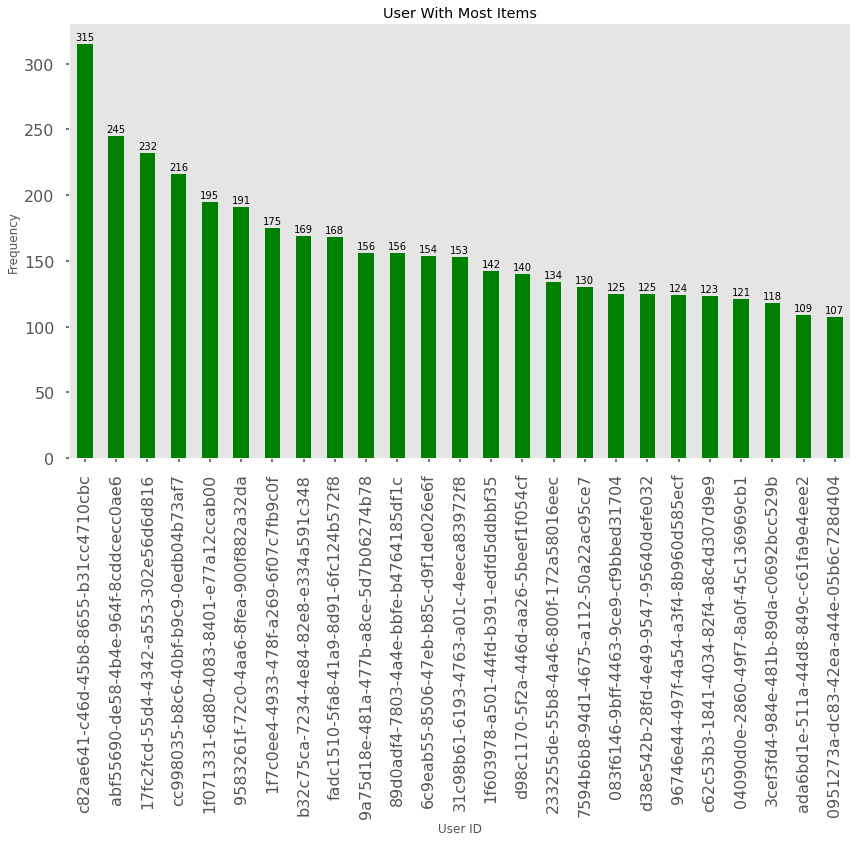

In [80]:
ax = products_df['user_uuid'].value_counts().nlargest(25).plot(kind='bar',
                                    figsize=(14,8),
                                    color = 'green',
                                    title = 'User With Most Items')

for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
# Turns off grid on the left Axis.
ax.grid(False)

ax.set_xlabel("User ID")
ax.set_ylabel("Frequency")

#### Most popular Category

In [81]:
products_df.head(2)

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date
0,33949611-a3e4-440a-83b1-6cc1a2602b8b,06abe0e5-c408-4a33-9d81-5bfacc891f15,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,15000,0,0,1,2019-12-19 02:42:28
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28


In [82]:
products_df['category_uuid'].value_counts().to_frame()

,category_uuid
aa9c2861-90e8-4210-994b-332ecab092fd,19852
c017d107-84c1-4586-9cf5-b9858aa5ee89,519
0592663e-1848-4280-87b2-0ae0f95355a4,332
4c7be4f5-66cd-43fa-833e-92f003cb0b97,213
629f8836-8f7f-41e7-8a73-df0e7d623036,190
...,...
6ccc9a5b-2408-416d-885b-5cf5965b17e9,1
f652a45f-3cdb-4128-bcc7-f80c18c280c0,1
f72236d2-2362-412d-93d8-2da09203a3d4,1
07efeb2c-bef3-4ef6-af9d-ad9ed6a457b2,1


In [83]:
print('We have {} Categoty with items for sale.'.format(products_df['category_uuid'].nunique()))

We have 95 Categoty with items for sale.


Text(0, 0.5, 'Frequency')

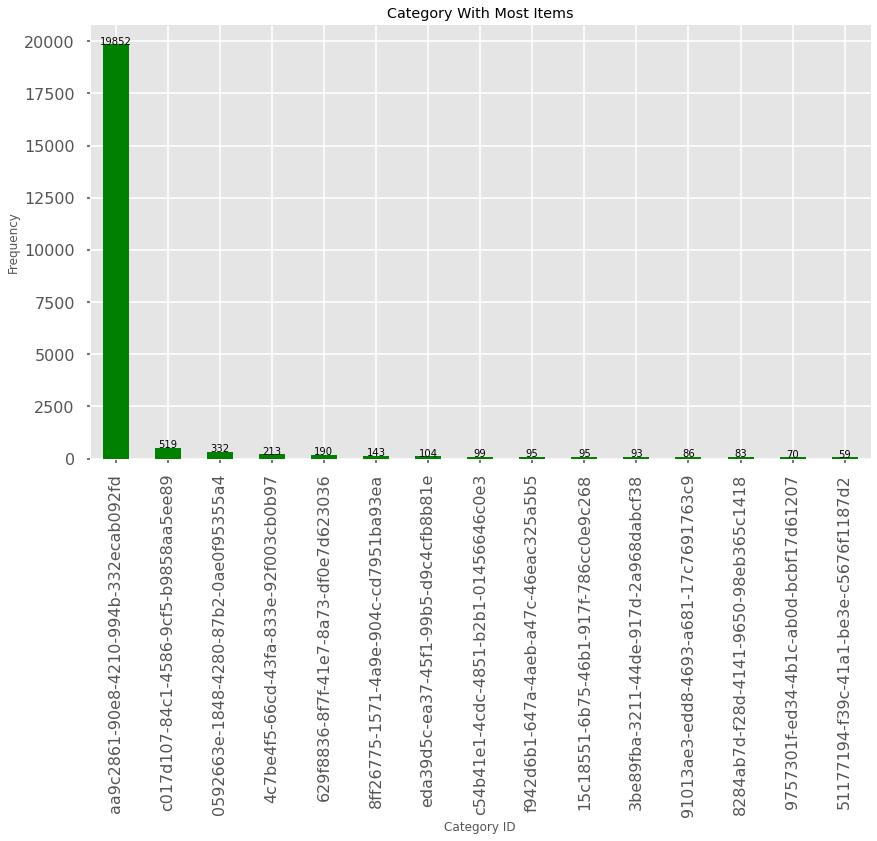

In [84]:
ax = products_df['category_uuid'].value_counts().nlargest(15).plot(kind='bar',
                                    figsize=(14,8),
                                    color = 'green',
                                    title="Category With Most Items")

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
ax.set_xlabel("Category ID")
ax.set_ylabel("Frequency")

####  Cities with most Item

In [85]:
products_df['city_uuid'].value_counts().to_frame()

,city_uuid
d29f1e68-56ce-476f-b09b-c960a4f5674f,6531
22972566-8739-40ca-bf19-a270d320dc83,5454
b4716b80-6d6b-4bdf-82f3-8a735760806c,1506
308873a5-249c-4bd3-b721-9e5aa54cd0ce,1007
017fea31-2ded-4a6f-b9cf-3e4a9d0fb799,886
...,...
7bee8007-467f-433c-9031-dec06f0e78f5,1
b1482ec4-90c2-4960-a9f2-b9326059b883,1
5e2dc764-d3b4-4bf1-8340-025e52924b77,1
7a66c2c3-7a93-46d0-b9b1-d805ca2eb0eb,1


In [86]:
print('We have {} cities with items for sale.'.format(products_df['city_uuid'].nunique()))

We have 193 cities with items for sale.


Text(0, 0.5, 'Frequency')

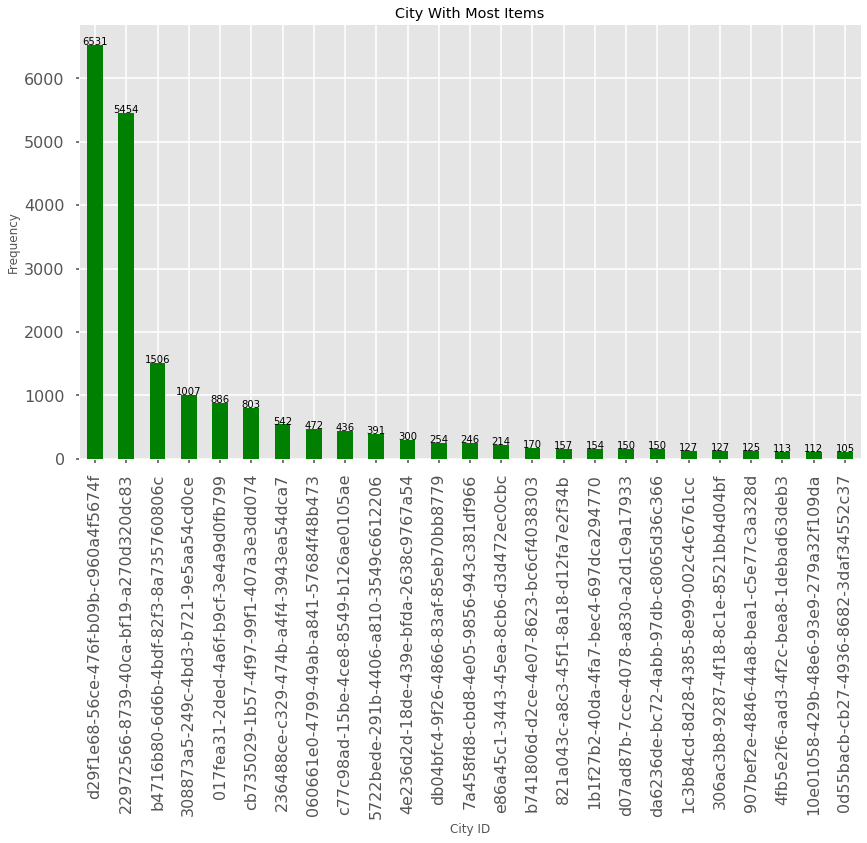

In [87]:
ax = products_df['city_uuid'].value_counts().nlargest(25).plot(kind='bar',
                                    figsize=(14,8),
                                    color = 'green',
                                    title="City With Most Items")

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
    
ax.set_xlabel("City ID")
ax.set_ylabel("Frequency")

#### New vs Old

Text(0, 0.5, 'Frequency')

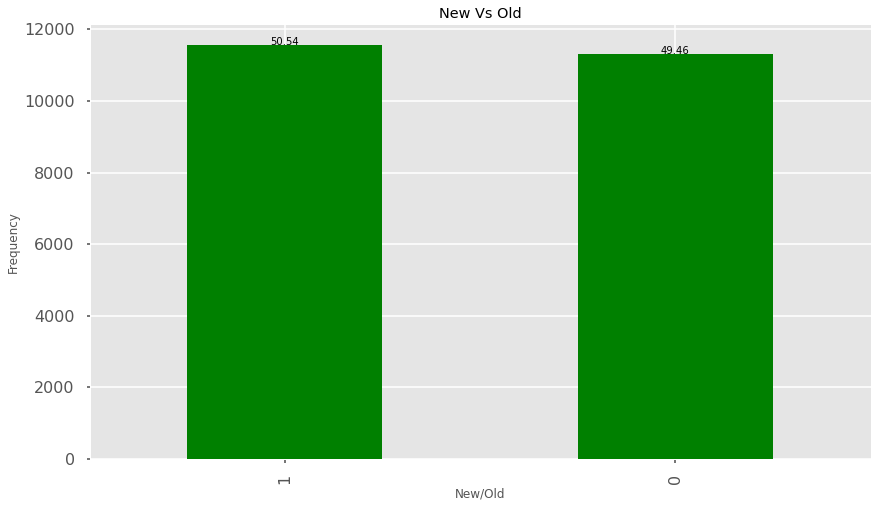

In [88]:
ax = products_df['is_new'].value_counts().plot(kind='bar',
                                    figsize=(14,8),
                                    color = 'green',
                                    title="New Vs Old")
#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}'.format((height/products_df.shape[0])*100),
            ha="center") 

ax.set_xlabel("New/Old")
ax.set_ylabel("Frequency")

#### Homemade vs Manufactured

Text(0, 0.5, 'Frequency')

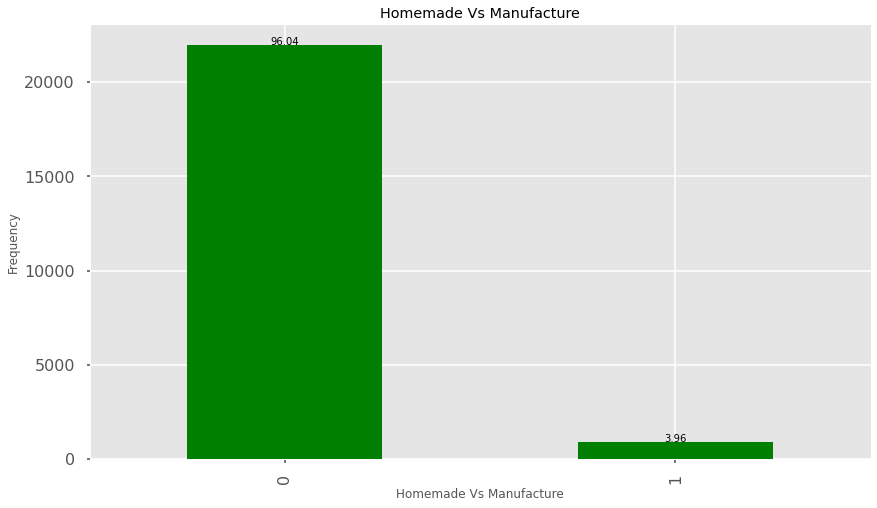

In [89]:
ax = products_df['is_homemade'].value_counts().plot(kind='bar',
                                    figsize=(14,8),
                                    color = 'green',
                                    title="Homemade Vs Manufacture")

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}'.format((height/products_df.shape[0])*100),
            ha="center") 
    
    
ax.set_xlabel("Homemade Vs Manufactured")
ax.set_ylabel("Frequency")

#### Orginal Price Distribution

In [90]:
products_df.original_price.describe()

count        22893.000
mean       1516705.384
std       49605537.705
min              0.000
25%          60000.000
50%         120000.000
75%         200000.000
max     2147483647.000
Name: original_price, dtype: float64

In [91]:
product_p = products_df['original_price'].value_counts().to_frame().reset_index()
product_p.rename(columns = {'index' : 'original_price', 'original_price':'count'}, inplace = True)
product_p.head(5)

,original_price,count
0,150000,1218
1,100000,1182
2,0,1143
3,120000,1093
4,50000,930


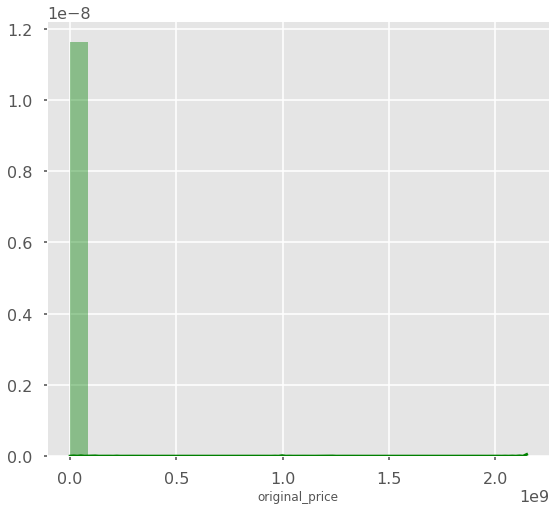

In [92]:
plt.figure(figsize=(9, 8))
sns.distplot(products_df['original_price'], color='g', bins=25, hist_kws={'alpha': 0.4});

In [93]:
print('The highest price: ',products_df['original_price'].max())
print('The highest price: ',products_df['original_price'].min())

The highest price:  2147483647
The highest price:  0


It seems your histogram is heavily Long-Tailed. As we have prices up to 2*1e9 while the majority of data are much smaller, in the order of 1e6. So the bin=25 parameter does such that the first bin includes almost all of the data. 
We should use logarithmic bins 

In [94]:
price = products_df[['original_price','price']]
price = price[price['original_price']!=0]

Text(0.5, 0, 'Log-Unit-Price')

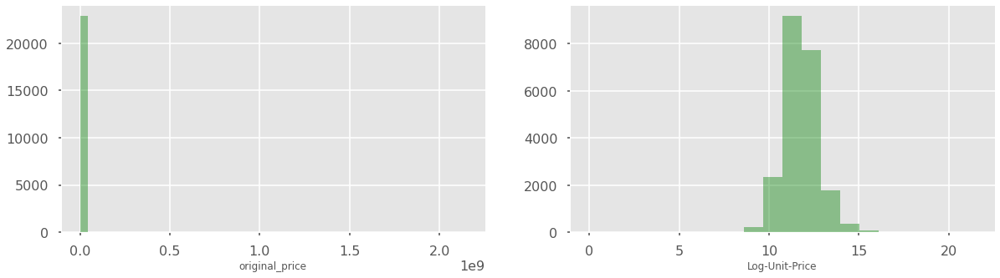

In [95]:
fig, ax = plt.subplots(1,2,figsize=(20,5))
sns.distplot(products_df.original_price, ax=ax[0], kde=False, color="g")
sns.distplot(np.log(price['original_price']), ax=ax[1], bins=20, color="g", kde=False)
ax[1].set_xlabel("Log-Unit-Price")

#### Show Orginal Price distribution using custom bins

In [96]:
products_df.head(2)

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date
0,33949611-a3e4-440a-83b1-6cc1a2602b8b,06abe0e5-c408-4a33-9d81-5bfacc891f15,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,15000,0,0,1,2019-12-19 02:42:28
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28


In [97]:
print(' Number of Item with price of 0         : ' , len(products_df[products_df['original_price']==0]))
print(' Number of Item with price other than 0 : ' , len(products_df[products_df['original_price']!=0]))

 Number of Item with price of 0         :  1143
 Number of Item with price other than 0 :  21750


In [98]:
product_non_zero_org_price = products_df[products_df['original_price']!=0]
product_non_zero_org_price.head(2)

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28
2,d895881f-6570-4ab6-9756-367c12b1ab44,16848d64-b555-4182-a5b4-c0ae1e850e01,8ff26775-1571-4a9e-904c-cd7951ba93ea,22972566-8739-40ca-bf19-a270d320dc83,1,0,92000,50000,1,4,1,2019-12-19 02:42:28


Unfortunately, We have **1143** item with price of zero! I believe this would make problem when we want to visualize our data, so I eliminate them for the visualization. We want to know the distribution of the item with prices and  not zero price right?!

In [99]:
product_non_zero_org_price['bucket_orginal'] = pd.cut(product_non_zero_org_price.original_price, 100000 , include_lowest= True)
product_non_zero_org_price.head()

<ipython-input-99-a00262e7e817>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  product_non_zero_org_price['bucket_orginal'] = pd.cut(product_non_zero_org_price.original_price, 100000 , include_lowest= True)


,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date,bucket_orginal
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28,"(536871.911, 558346.748]"
2,d895881f-6570-4ab6-9756-367c12b1ab44,16848d64-b555-4182-a5b4-c0ae1e850e01,8ff26775-1571-4a9e-904c-cd7951ba93ea,22972566-8739-40ca-bf19-a270d320dc83,1,0,92000,50000,1,4,1,2019-12-19 02:42:28,"(85900.346, 107375.182]"
3,c0a45353-2453-442f-ae45-d741ac5ecdc3,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,310000,230000,6,1,1,2020-04-19 14:49:54,"(300648.71, 322123.547]"
4,00871ece-294a-4b1e-be51-2d72ac1205f7,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,310000,230000,4,0,1,2020-04-19 14:53:57,"(300648.71, 322123.547]"
5,87857c5d-e2df-4118-a822-e7285c78b814,16848d64-b555-4182-a5b4-c0ae1e850e01,c017d107-84c1-4586-9cf5-b9858aa5ee89,22972566-8739-40ca-bf19-a270d320dc83,1,0,150000,98000,0,0,1,2020-05-15 14:23:33,"(128850.019, 150324.855]"


In [100]:
product_price_buckets = product_non_zero_org_price[['bucket_orginal','uuid']].groupby('bucket_orginal').count()
product_price_buckets.head()

,uuid
bucket_orginal,
"(-2147482.6470000003, 21475.836]",541
"(21475.836, 42950.673]",1700
"(42950.673, 64425.509]",2578
"(64425.509, 85900.346]",2750
"(85900.346, 107375.182]",2249


Text(0, 0.5, 'Frequency')

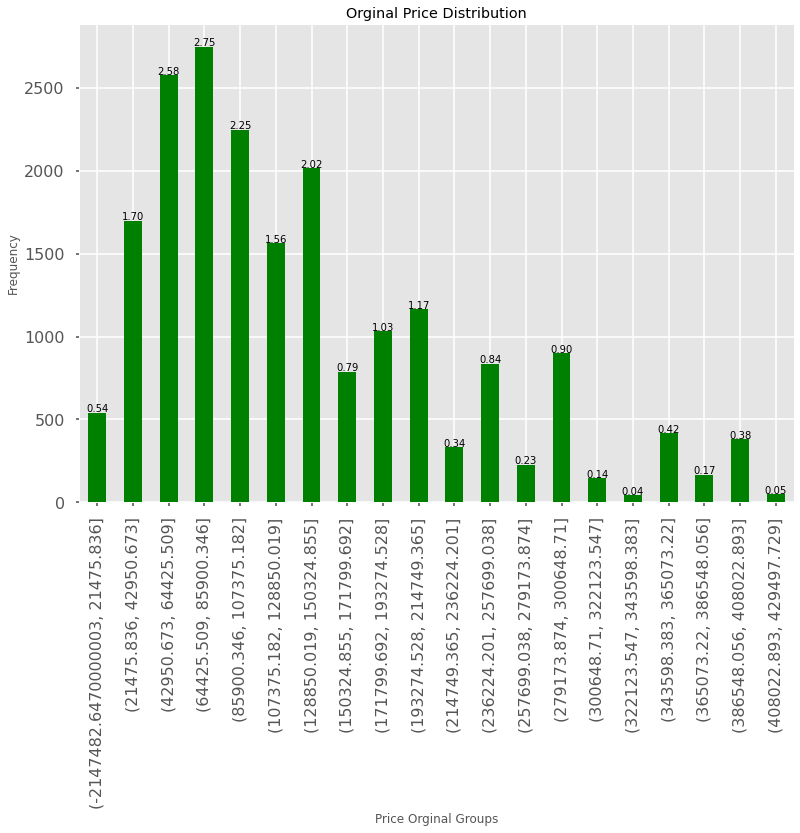

In [101]:
ax = product_price_buckets.head(20).plot(kind='bar',title="Orginal Price Distribution", legend = False , color = 'green')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}'.format((height/product_price_buckets.shape[0])*100),
            ha="center") 
    
ax.set_xlabel("Price Orginal Groups")
ax.set_ylabel("Frequency")

#### Price Distribution

In [102]:
products_df.price.describe()

count        22893.000
mean        226696.368
std       15531095.684
min              0.000
25%          27000.000
50%          50000.000
75%          90000.000
max     2147483647.000
Name: price, dtype: float64

In [103]:
product_price = products_df['price'].value_counts().to_frame().reset_index()
product_price.rename(columns = {'index' : 'price', 'price':'count'}, inplace = True)
product_price

,price,count
0,50000,1486
1,30000,1396
2,40000,1158
3,20000,1142
4,25000,1041
...,...,...
381,740000,1
382,55001,1
383,101000,1
384,1450000,1


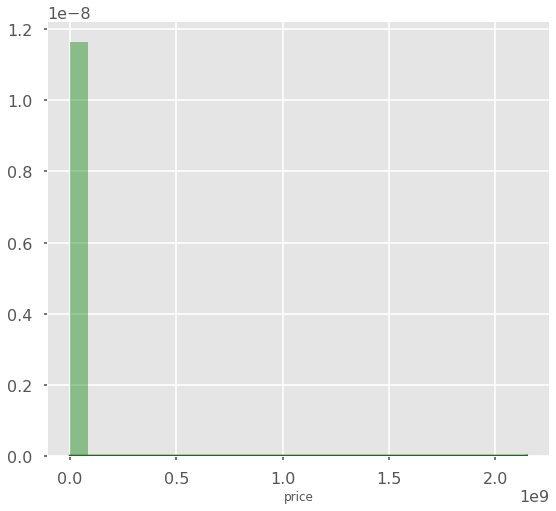

In [104]:
plt.figure(figsize=(9, 8))
sns.distplot(products_df['price'], color='g', bins=25, hist_kws={'alpha': 0.4});

In [105]:
print('The highest price: ',products_df['price'].max())
print('The highest price: ',products_df['price'].min())

The highest price:  2147483647
The highest price:  0


In [106]:
price = products_df[['original_price','price']]
price = price[price['original_price']!=0]

Text(0.5, 0, 'Log-Unit-Price')

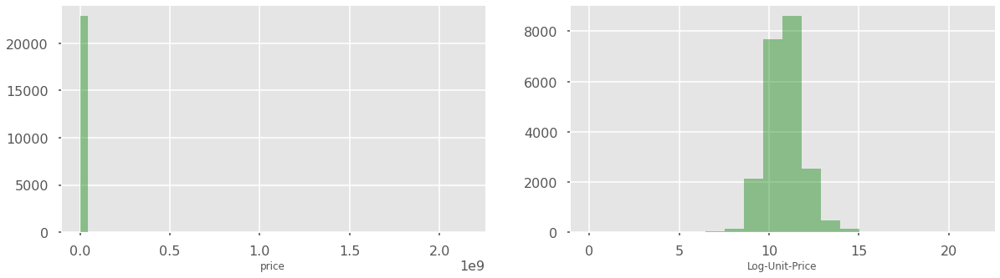

In [107]:
fig, ax = plt.subplots(1,2,figsize=(20,5))
sns.distplot(products_df.price, ax=ax[0], kde=False, color="g")
sns.distplot(np.log(price['price']), ax=ax[1], bins=20, color="g", kde=False)
ax[1].set_xlabel("Log-Unit-Price")

In [108]:
print(' Number of Item with discounted price of 0         : ' , len(products_df[products_df['price']==0]))
print(' Number of Item with discounted price other than 0 : ' , len(products_df[products_df['price']!=0]))

 Number of Item with discounted price of 0         :  63
 Number of Item with discounted price other than 0 :  22830


In [109]:
product_non_zero_dis_price = products_df[products_df['price']!=0]
product_non_zero_dis_price.head(2)

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date
0,33949611-a3e4-440a-83b1-6cc1a2602b8b,06abe0e5-c408-4a33-9d81-5bfacc891f15,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,15000,0,0,1,2019-12-19 02:42:28
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28


In [110]:
product_non_zero_dis_price['bucket_discounted'] = pd.cut(product_non_zero_dis_price.price, 100000 , include_lowest= True)
product_non_zero_dis_price.head()

<ipython-input-110-ace414813ee7>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  product_non_zero_dis_price['bucket_discounted'] = pd.cut(product_non_zero_dis_price.price, 100000 , include_lowest= True)


,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date,bucket_discounted
0,33949611-a3e4-440a-83b1-6cc1a2602b8b,06abe0e5-c408-4a33-9d81-5bfacc891f15,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,15000,0,0,1,2019-12-19 02:42:28,"(-2147482.6470000003, 21475.836]"
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28,"(279173.874, 300648.71]"
2,d895881f-6570-4ab6-9756-367c12b1ab44,16848d64-b555-4182-a5b4-c0ae1e850e01,8ff26775-1571-4a9e-904c-cd7951ba93ea,22972566-8739-40ca-bf19-a270d320dc83,1,0,92000,50000,1,4,1,2019-12-19 02:42:28,"(42950.673, 64425.509]"
3,c0a45353-2453-442f-ae45-d741ac5ecdc3,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,310000,230000,6,1,1,2020-04-19 14:49:54,"(214749.365, 236224.201]"
4,00871ece-294a-4b1e-be51-2d72ac1205f7,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,310000,230000,4,0,1,2020-04-19 14:53:57,"(214749.365, 236224.201]"


In [111]:
product_dis_price_buckets = product_non_zero_dis_price[['bucket_discounted','uuid']].groupby('bucket_discounted').count()
product_dis_price_buckets.head()

,uuid
bucket_discounted,
"(-2147482.6470000003, 21475.836]",4245
"(21475.836, 42950.673]",5891
"(42950.673, 64425.509]",4059
"(64425.509, 85900.346]",2634
"(85900.346, 107375.182]",1724


Text(0, 0.5, 'Frequency')

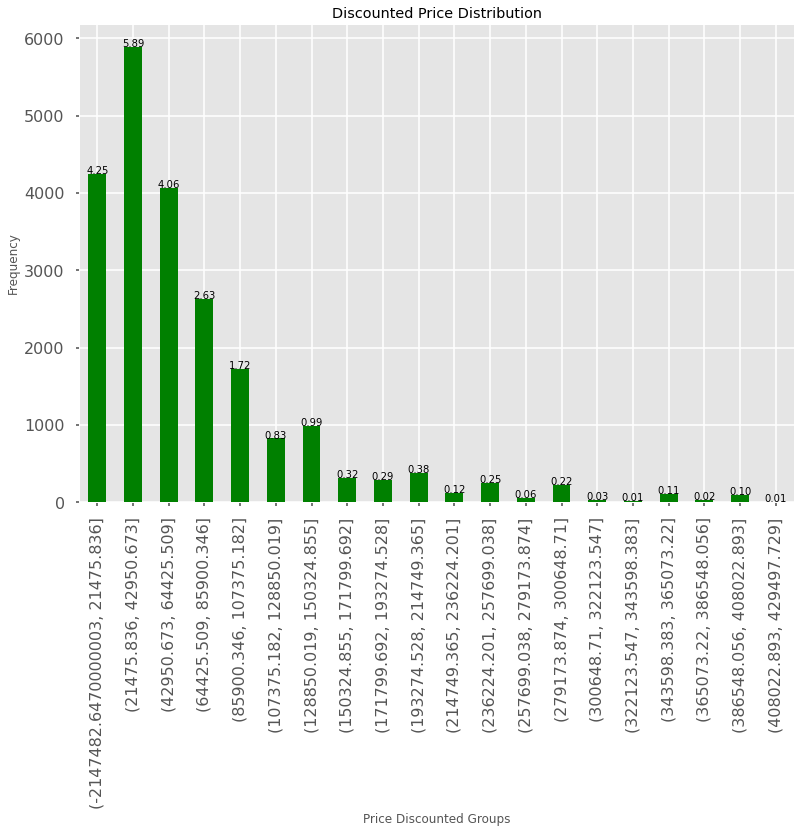

In [112]:
ax = product_dis_price_buckets.head(20).plot(kind='bar',title="Discounted Price Distribution", legend = False , color = 'green')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.2f}'.format((height/product_dis_price_buckets.shape[0])*100),
            ha="center") 
    
ax.set_xlabel("Price Discounted Groups")
ax.set_ylabel("Frequency")

#### Items with most Discount

In [113]:
products_df['discount']= products_df['original_price'] - products_df['price']

In [114]:
products_df.head(2)

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date,discount
0,33949611-a3e4-440a-83b1-6cc1a2602b8b,06abe0e5-c408-4a33-9d81-5bfacc891f15,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,15000,0,0,1,2019-12-19 02:42:28,-15000
1,a55fbc5e-b0b1-43c8-b25b-57685d2ee242,16848d64-b555-4182-a5b4-c0ae1e850e01,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,550000,300000,0,1,1,2019-12-19 02:42:28,250000


In [115]:
products_df.sort_values('discount', inplace = True , ascending=False)
products_df.head()

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date,discount
10814,56d54b87-3a0f-4164-94d5-0217aa7bb8de,a9502826-05f5-4551-84b7-4ab459715245,aa9c2861-90e8-4210-994b-332ecab092fd,1b1f27b2-40da-4fa7-bec4-697dca294770,1,0,2147483647,10000,0,1,1,2019-12-19 02:42:28,2147473647
638,f7858eea-4370-410f-a77d-1260376e9f9f,85ba8dcc-eab6-47fb-a112-0f4fe72ef5a0,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,0,0,2147483647,25000,0,1,1,2019-12-19 02:42:28,2147458647
8514,c619c0ae-8f1f-412d-ab85-a54145a4cbe0,0d5f59d7-54db-46e5-866b-96ddf97f69db,aa9c2861-90e8-4210-994b-332ecab092fd,308873a5-249c-4bd3-b721-9e5aa54cd0ce,1,0,2147483647,35000,0,9,1,2019-12-19 02:42:28,2147448647
8513,87a5959f-8fdb-4966-9989-311c805932b2,0d5f59d7-54db-46e5-866b-96ddf97f69db,aa9c2861-90e8-4210-994b-332ecab092fd,308873a5-249c-4bd3-b721-9e5aa54cd0ce,1,0,2147483647,35000,0,0,1,2019-12-19 02:42:28,2147448647
639,82fbd4f9-47a1-445a-bbe8-72b687d2ac79,85ba8dcc-eab6-47fb-a112-0f4fe72ef5a0,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,0,0,2147483647,40000,0,3,1,2019-12-19 02:42:28,2147443647


In [116]:
products_df['category_uuid'].nunique()

95

In [117]:
print('Maximum Discount: ' , products_df.discount.max())
print('Minimum Discount: ' , products_df.discount.min())

Maximum Discount:  2147473647
Minimum Discount:  -1400000


In [118]:
discount_dis = pd.DataFrame(products_df.groupby([products_df["category_uuid"], products_df['discount']])['discount'].size())

In [119]:
discount_dis.rename(columns={'discount' : 'count'}, inplace = True)

In [120]:
discount_dis.head()

count
category_uuid                        discount       
00f9ebd7-76fa-46aa-ba7e-a6eea5bc8f28  20000        1
                                      30000        1
                                      40000        1
                                      130000       1
0592663e-1848-4280-87b2-0ae0f95355a4 -130000       1

#### Most Generous Cities

In [121]:
products_df.head(2)

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date,discount
10814,56d54b87-3a0f-4164-94d5-0217aa7bb8de,a9502826-05f5-4551-84b7-4ab459715245,aa9c2861-90e8-4210-994b-332ecab092fd,1b1f27b2-40da-4fa7-bec4-697dca294770,1,0,2147483647,10000,0,1,1,2019-12-19 02:42:28,2147473647
638,f7858eea-4370-410f-a77d-1260376e9f9f,85ba8dcc-eab6-47fb-a112-0f4fe72ef5a0,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,0,0,2147483647,25000,0,1,1,2019-12-19 02:42:28,2147458647


In [122]:
df = products_df[["category_uuid", "city_uuid" , "discount"]]

In [123]:
df.head()

,category_uuid,city_uuid,discount
10814,aa9c2861-90e8-4210-994b-332ecab092fd,1b1f27b2-40da-4fa7-bec4-697dca294770,2147473647
638,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,2147458647
8514,aa9c2861-90e8-4210-994b-332ecab092fd,308873a5-249c-4bd3-b721-9e5aa54cd0ce,2147448647
8513,aa9c2861-90e8-4210-994b-332ecab092fd,308873a5-249c-4bd3-b721-9e5aa54cd0ce,2147448647
639,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,2147443647


In [124]:
df.groupby(['city_uuid','category_uuid']).sum()

discount
city_uuid                            category_uuid                                 
00a6e24d-57b3-4284-97ad-82ab78f7e97d aa9c2861-90e8-4210-994b-332ecab092fd    180000
017fea31-2ded-4a6f-b9cf-3e4a9d0fb799 0592663e-1848-4280-87b2-0ae0f95355a4   2302400
                                     15c18551-6b75-46b1-917f-786cc0e9c268   3915000
                                     37978d09-0fc2-466e-b9d6-081eea95c8d5    191000
                                     3be89fba-3211-44de-917d-2a968dabcf38    470000
...                                                                             ...
f9bedfa1-deaf-41cd-8c06-f6e010a3b487 4c7be4f5-66cd-43fa-833e-92f003cb0b97     58000
                                     aa9c2861-90e8-4210-994b-332ecab092fd   1974000
                                     f02e4eb6-c0a5-4a2a-a48f-687ae8407c67    348000
fb52139d-8de9-44e9-b4e6-f0e7b87d6cdf aa9c2861-90e8-4210-994b-332ecab092fd     20000
fb728ded-0321-4a80-b0f5-6ff0ca16bf74 aa9c2861-90e8-4210-994b-332ecab092fd   2945000

[885 rows x 1 columns]

In [125]:
city_dis = df.groupby(['city_uuid'])['discount'].mean().to_frame()
city_dis.head()

,discount
city_uuid,
00a6e24d-57b3-4284-97ad-82ab78f7e97d,90000.000
017fea31-2ded-4a6f-b9cf-3e4a9d0fb799,223799.758
02bcddec-e7ed-4163-a6b5-dc5fe1e98702,18333.333
02f205d0-ef0e-4a8a-af7f-2b6274b64d30,132402.439
04965e51-5904-4b18-bd27-66e58f2871c5,169684.211


In [126]:
city_dis.sort_values('discount', inplace = True , ascending=False)
city_dis.head(15)

,discount
city_uuid,
abc73f98-bb8d-4606-923e-60094433a9b0,268483580.875
59c39f09-0334-4a80-91d2-5bef8ad778ea,35881544.117
358bdb48-8a03-496d-9dde-c06eb65836c1,17411513.203
1b1f27b2-40da-4fa7-bec4-697dca294770,14009004.201
907bef2e-4846-44a8-bea1-c5e77c3a328d,9969271.136
308873a5-249c-4bd3-b721-9e5aa54cd0ce,6613479.234
146c7757-c541-4182-8425-4ba291bc0fda,3334666.667
d29f1e68-56ce-476f-b09b-c960a4f5674f,1822967.444
fb728ded-0321-4a80-b0f5-6ff0ca16bf74,1472500.000


Text(0, 0.5, 'َAverage Discount')

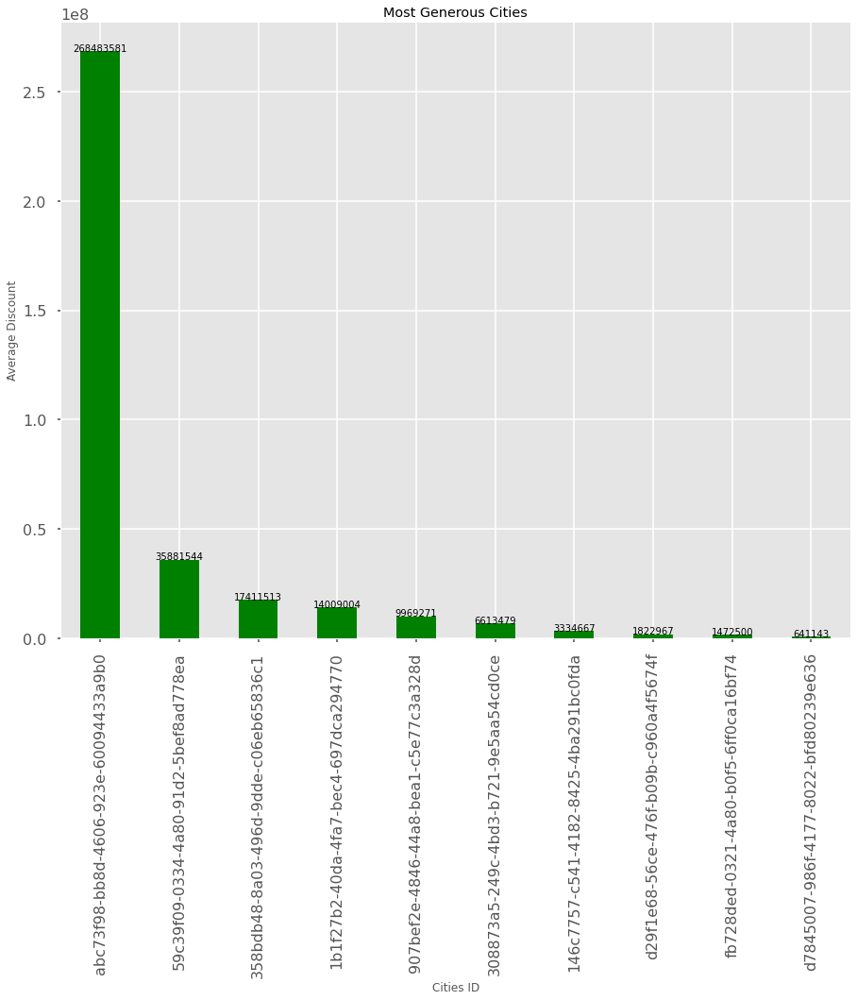

In [127]:
ax = city_dis.head(10).plot(kind='bar', legend = False, color = 'green',figsize=(15,12), title='Most Generous Cities')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
ax.set_xlabel("Cities ID")
ax.set_ylabel("َAverage Discount")

#### Category with most discount

In [128]:
category_dis = df.groupby(['category_uuid'])['discount'].mean().to_frame()
category_dis.head()

,discount
category_uuid,
00f9ebd7-76fa-46aa-ba7e-a6eea5bc8f28,55000.000
0592663e-1848-4280-87b2-0ae0f95355a4,134996.837
07efeb2c-bef3-4ef6-af9d-ad9ed6a457b2,150000.000
0da51c68-41fc-4d3f-9d7c-ed39829ab785,28428.571
109d7b9c-5f07-423c-8db8-8aa828d6989e,147191.489


In [129]:
category_dis.sort_values('discount', inplace = True , ascending=False)
category_dis.head(15)

,discount
category_uuid,
662878cf-2e1a-4a4c-8c87-7c6357e09eef,1850000.000
c88772c2-d432-4d7c-a5cd-447d0d1d02f4,1830241.379
67373dce-1a79-48d2-ab18-cc1386d90f70,1725196.078
aa9c2861-90e8-4210-994b-332ecab092fd,1457958.763
a2ab5b87-7d29-4c7f-bcfa-b91ac733c7aa,700000.000
68ba37e5-6495-4dfd-8157-6912aa0bd109,505138.889
38c0bdec-4193-4bce-87cd-ade43248c379,315000.000
d0dfab04-4ace-4f26-9ff2-6d51967f8b7c,300000.000
530e7f1b-5a09-4a62-9748-595304aaa60b,300000.000


Text(0, 0.5, 'َAverage Discount')

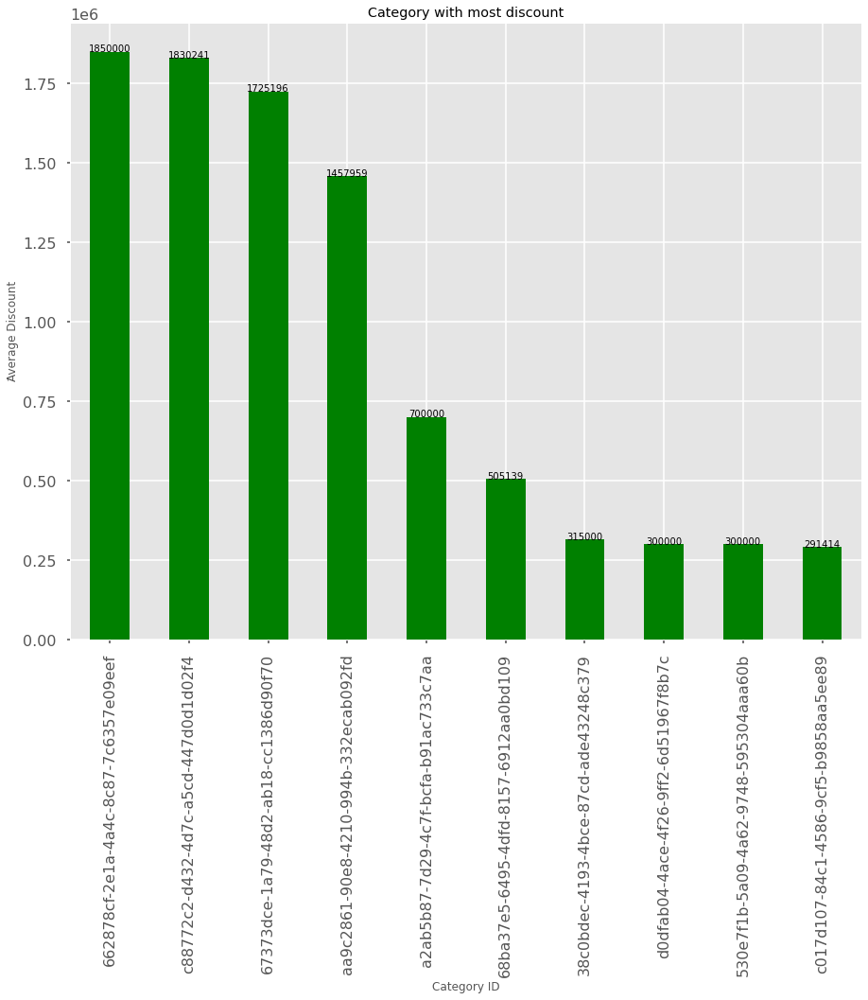

In [130]:
ax = category_dis.head(10).plot(kind='bar', legend = False, color = 'green',figsize=(15,12), title='Category with most discount')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
ax.set_xlabel("Category ID")
ax.set_ylabel("َAverage Discount")

#### Most Generous users

In [131]:
user_dis = products_df.groupby(['user_uuid'])['discount'].mean().to_frame()
user_dis.head()

,discount
user_uuid,
00016ef8-b6d3-4f67-8ba3-97146317f212,-50000.000
0008cf8e-57ec-4981-9c57-7dc6f817d215,64000.000
0023faeb-5abe-43fd-9c04-8f6701e55dfb,38333.333
004c68ec-c8e7-4e98-aab6-04fe47332881,20000.000
0081fc53-45e5-4422-a9bc-c1c9a9d0e0be,9000.000


In [132]:
user_dis.sort_values('discount', inplace = True , ascending=False)
user_dis.head(15)

,discount
user_uuid,
85ba8dcc-eab6-47fb-a112-0f4fe72ef5a0,786879661.750
0d5f59d7-54db-46e5-866b-96ddf97f69db,429514596.067
20de7c58-b721-40ea-933b-999f6d396d3a,306916235.286
a9502826-05f5-4551-84b7-4ab459715245,268547955.875
b9014d2a-f1e2-4f04-9481-5803ba68dd29,179012387.250
14b8bbd2-eb47-4138-a262-e8f09b775f33,79657246.185
85139b67-66be-4a37-bd88-2727f09293e8,35003620.690
66c89729-68e2-4f4d-9273-3b8db4f2f3ff,26352342.105
2106d03c-9c05-4e96-a7b4-8b2bf9258c3a,25270886.449


Text(0, 0.5, 'َAverage Discount')

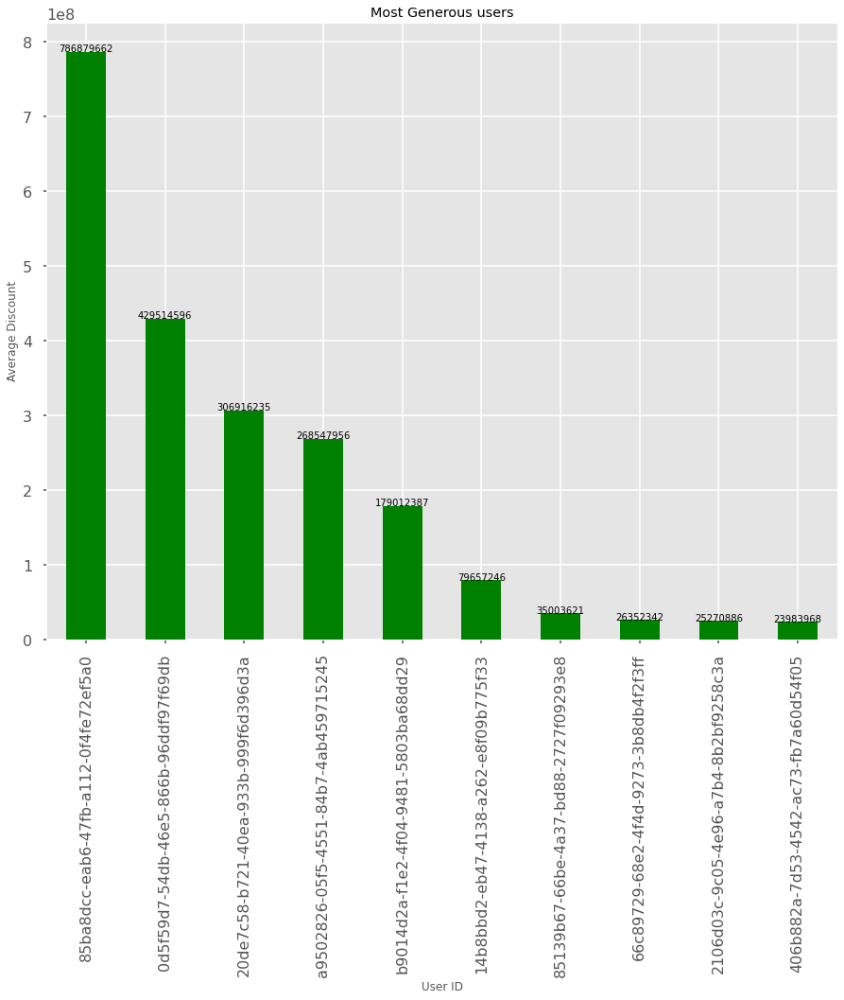

In [133]:
ax = user_dis.head(10).plot(kind='bar', legend = False, color = 'green',figsize=(15,12), title='Most Generous users')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
ax.set_xlabel("User ID")
ax.set_ylabel("َAverage Discount")

#### Items with most Comments and Items with most bookmarks (Hot Items)

##### Comments

Text(0, 0.5, 'Number of Item ')

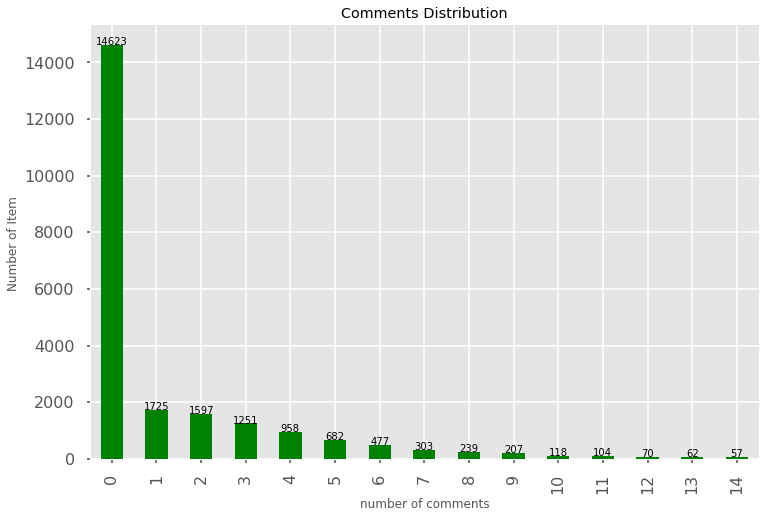

In [134]:
ax = products_df['comments_count'].value_counts().head(15).plot(kind='bar', legend = False, color = 'green',figsize=(12,8), title='Comments Distribution')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
ax.set_xlabel("number of comments")
ax.set_ylabel("Number of Item ")

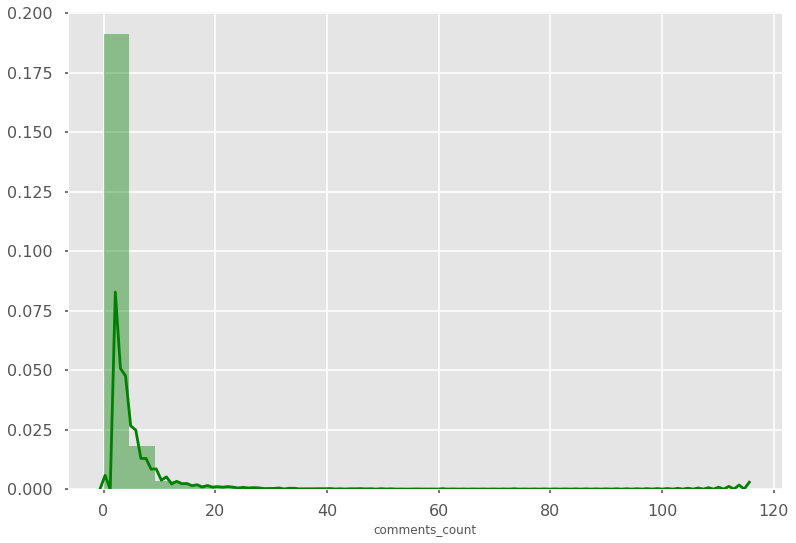

In [135]:
plot = sns.distplot(products_df.comments_count,
             bins=25,
             color="green")

#### bookmarks

Text(0, 0.5, 'Number of Item')

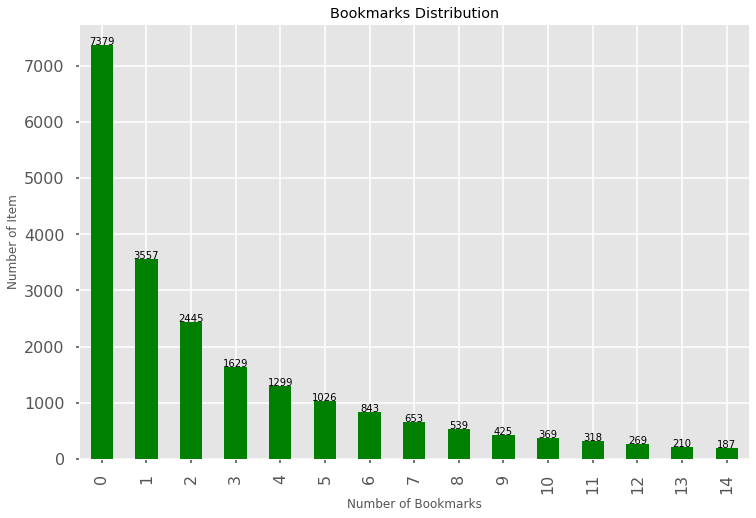

In [136]:
ax = products_df['bookmarks_count'].value_counts().head(15).plot(kind='bar', legend = False, color = 'green',figsize=(12,8), title='Bookmarks Distribution')

#annotate axis = seaborn axis
for p in ax.patches:
    height = p.get_height()
    ax.text(p.get_x()+p.get_width()/2.,
            height + 3,
            '{:1.0f}'.format(height),
            ha="center") 
    
ax.set_xlabel("Number of Bookmarks")
ax.set_ylabel("Number of Item")

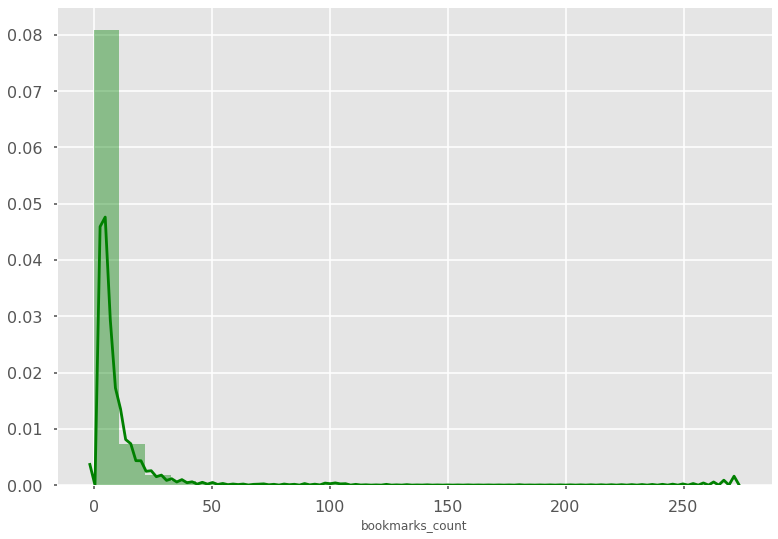

In [137]:
plot = sns.distplot(products_df.bookmarks_count,
             bins=25,
             color="green")

#### Gender Distiribution of the items

In [138]:
products_df.columns

Index(['uuid', 'user_uuid', 'category_uuid', 'city_uuid', 'is_new',
       'is_homemade', 'original_price', 'price', 'comments_count',
       'bookmarks_count', 'gender', 'date', 'discount'],
      dtype='object')

Text(0, 0.5, 'Frequency')

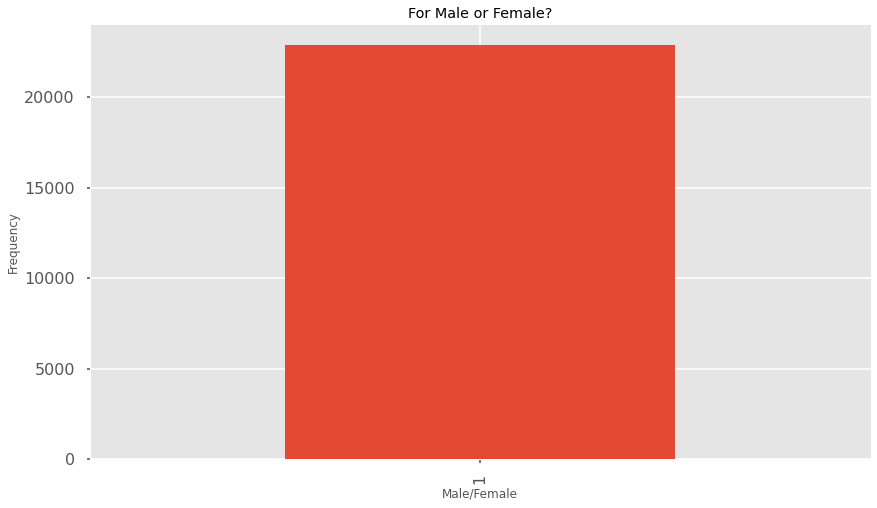

In [139]:
ax = products_df['gender'].value_counts().plot(kind='bar',
                                    figsize=(14,8),
                                    title="For Male or Female?")
ax.set_xlabel("Male/Female")
ax.set_ylabel("Frequency")

In [140]:
products_df['gender'].value_counts()

1    22893
Name: gender, dtype: int64

Wow! All of the clothes are for men only!

#### Month and Categories

In [141]:
products_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 22893 entries, 10814 to 12413
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   uuid             22893 non-null  object
 1   user_uuid        22893 non-null  object
 2   category_uuid    22893 non-null  object
 3   city_uuid        22893 non-null  object
 4   is_new           22893 non-null  int64 
 5   is_homemade      22893 non-null  int64 
 6   original_price   22893 non-null  int64 
 7   price            22893 non-null  int64 
 8   comments_count   22893 non-null  int64 
 9   bookmarks_count  22893 non-null  int64 
 10  gender           22893 non-null  int64 
 11  date             22893 non-null  object
 12  discount         22893 non-null  int64 
dtypes: int64(8), object(5)
memory usage: 2.4+ MB


In [142]:
products_df["date"] = pd.to_datetime(products_df.date, cache=True)

print("Start Of The Period: " , products_df.date.min())
print("End Of The Period  : " , products_df.date.max() )
print("Time Period        : " , products_df.date.max() - products_df.date.min())

Start Of The Period:  2019-12-19 02:42:28
End Of The Period  :  2020-09-16 14:29:20
Time Period        :  272 days 11:46:52


In [143]:
categories_month_count = pd.DataFrame(products_df.groupby([pd.to_datetime(products_df["date"]).dt.to_period('M'), products_df.category_uuid])['category_uuid'].
                                  count())

In [144]:
categories_month_count.rename(columns = {'category_uuid' : 'count'},inplace = True)
categories_month_count

count
date    category_uuid                              
2019-12 0592663e-1848-4280-87b2-0ae0f95355a4    148
        0da51c68-41fc-4d3f-9d7c-ed39829ab785      1
        109d7b9c-5f07-423c-8db8-8aa828d6989e      2
        109e52c9-b8ce-4c24-b693-56a76a361a0d      3
        15c18551-6b75-46b1-917f-786cc0e9c268     80
...                                             ...
2020-09 c2d8bd72-3e93-4db8-8b2f-47825445928d      1
        c54b41e1-4cdc-4851-b2b1-01456646c0e3      7
        d06ba9f8-d3d8-403e-9807-ca9be9122ef7      3
        eda39d5c-ea37-45f1-99b5-d9c4cfb8b81e      1
        ffa7c9df-e9b8-44d8-a0a6-c1cd0de75132      2

[370 rows x 1 columns]

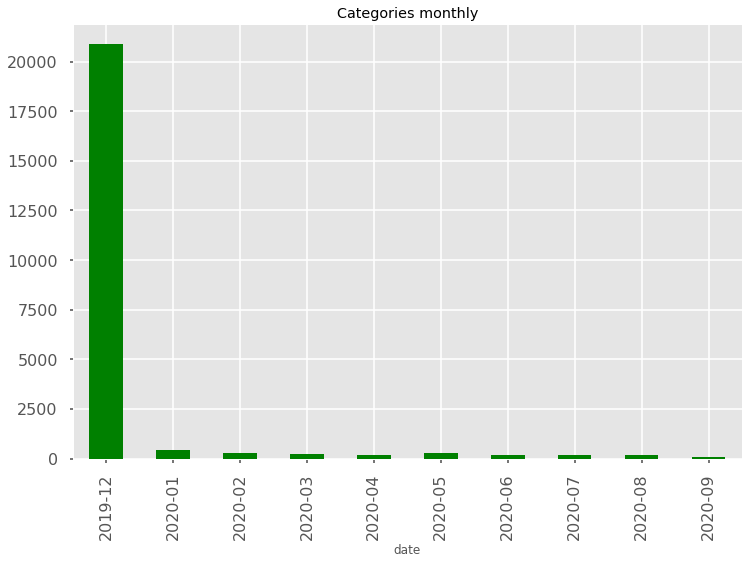

In [145]:
products_df.groupby(pd.to_datetime(products_df["date"]).dt.to_period('M'))['uuid'].count().plot(kind='bar', legend = False, color = 'green',figsize=(12,8),
                                                                                                title='Categories monthly')


In [146]:
categories_month_count.reset_index(inplace = True)
categories_month_count = categories_month_count[categories_month_count['count']>15]

In [147]:
li_date = categories_month_count.date.unique()

Text(0, 0.5, 'Number Of items')

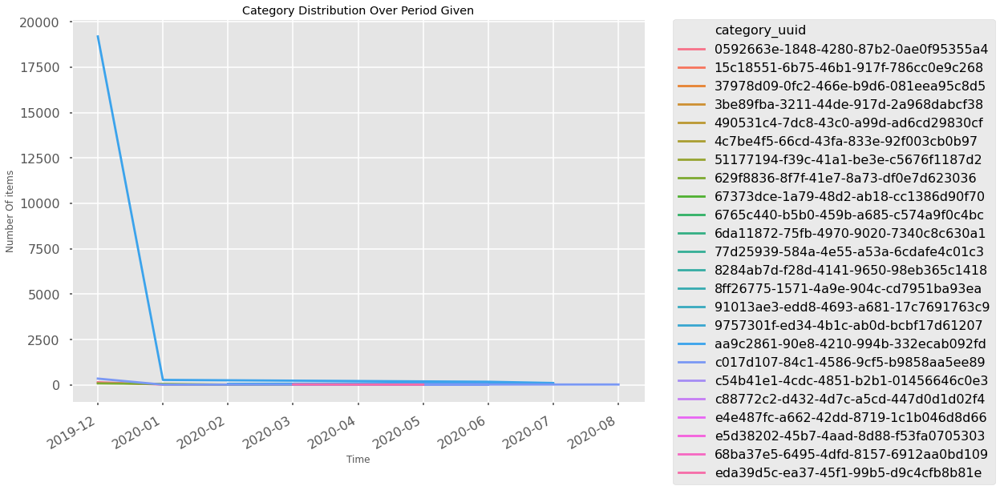

In [148]:
plot = sns.lineplot(x=categories_month_count['date'].astype(str), y='count', hue='category_uuid', data=categories_month_count)


plot.set_xticklabels(li_date,rotation=30, horizontalalignment='right')
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

# Add title and axis names
plt.title('Category Distribution Over Period Given')
plt.xlabel('Time', fontsize='12')
plt.ylabel('Number Of items')

In [149]:
# plot data
# fig, ax = plt.subplots(figsize=(20,10))
# pd.DataFrame(products_df.groupby([pd.to_datetime(products_df["date"]).dt.to_period('M'), products_df.category_uuid],sort=True)['category_uuid'].
#              count()).unstack().plot(ax=ax, legend = False)

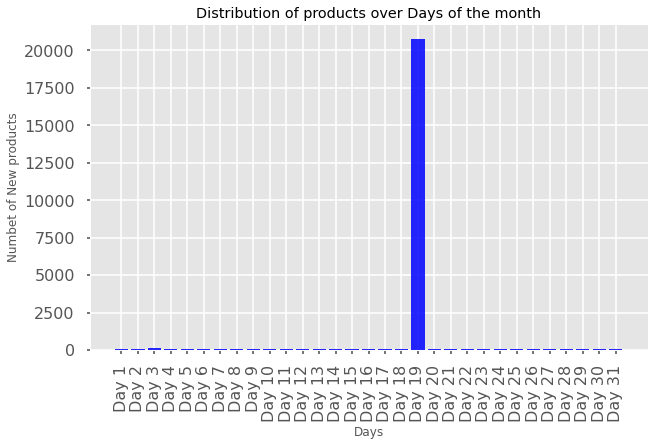

In [150]:
# Daily distribution count
daily_count = products_df.groupby(products_df["date"].dt.day, as_index = False).count()

fig= plt.figure(figsize=(10,6))

# Choose the names of the bars
bars = []
for i in range(1,32):
    bars.append('Day '+str(i))

y_pos = np.arange(len(bars))
 
# Create bars
plt.bar(y_pos, daily_count.date, color = 'Blue', alpha = 0.85)
 
# Create names on the x-axis
plt.xticks(y_pos, bars, rotation=90)
plt.yticks()

# Add title and axis names
plt.title('Distribution of products over Days of the month')
plt.xlabel('Days', fontsize='12')
plt.ylabel('Numbet of New products')

 
# Show graphic
plt.savefig('Images/Distribution of new products over days.png',bbox_inches = 'tight')
plt.show()


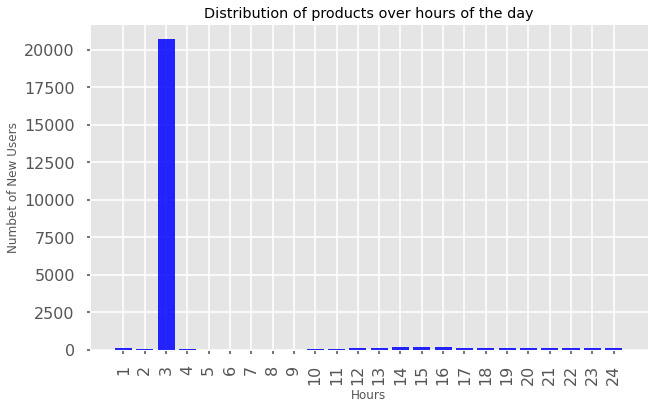

In [151]:
# Monthly distribution count
hourly_count = products_df.groupby(products_df["date"].dt.hour, as_index = False).count()

fig= plt.figure(figsize=(10,6))

# Choose the names of the bars
bars = []
for i in range(1,25):
    bars.append(str(i))

y_pos = np.arange(len(bars))
 
# Create bars
plt.bar(y_pos, hourly_count.date,color = 'Blue', alpha = 0.85)
 
# Create names on the x-axis
plt.xticks(y_pos, bars, rotation=90)
plt.yticks()

# Add title and axis names
plt.title('Distribution of products over hours of the day')
plt.xlabel('Hours', fontsize='12')
plt.ylabel('Numbet of New Users')

 
# Show graphic
plt.savefig('Images/Distribution of products over hours.png',bbox_inches = 'tight')
plt.show()

##### Month and Discount

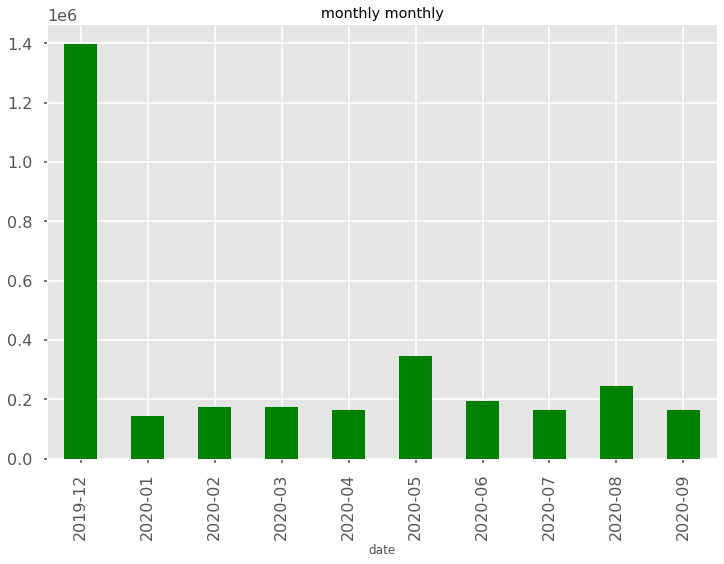

In [152]:
categories_month_count = pd.DataFrame(products_df.groupby(pd.to_datetime(products_df["date"]).dt.to_period('M'))['discount'].mean()).plot(kind='bar', legend = False,
                                                                                                                                          color = 'green',figsize=(12,8),
                                                                                                                                          title='monthly monthly')

In [153]:
products_df.groupby(pd.to_datetime(products_df["date"]).dt.to_period('M'))['discount'].mean().to_frame()

,discount
date,
2019-12,1396233.645
2020-01,145243.990
2020-02,172504.983
2020-03,172838.174
2020-04,162410.372
2020-05,344307.865
2020-06,194802.956
2020-07,164151.163
2020-08,244211.765


## Purchase DataFrame

#### To Do List
1. Users with Most purchase
2. Seasons with Most Purchase

In [154]:
purchase_df = pd.read_csv('komodaa/purchases.csv')
purchase_df.head()

,buyer_uuid,product_uuid,count,date
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52
1,970ef8d9-c50e-4821-9687-145379af2b9a,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16
2,970ef8d9-c50e-4821-9687-145379af2b9a,ecd1b68f-9db4-49f5-bac5-5679d9f9d784,1,2018-03-01 15:10:23
3,0bc6742f-d58a-4539-b85b-62bc3463033b,af59299c-2d08-4993-9be0-cfd7e641ae0d,1,2017-12-17 12:49:20
4,233255de-55b8-4a46-800f-172a58016eec,0cd2b781-bd44-40cf-9422-a50dac21f4b5,1,2018-03-12 20:26:13


In [155]:
purchase_df['count'].value_counts()

1    184
Name: count, dtype: int64

##### Users with Most purchase

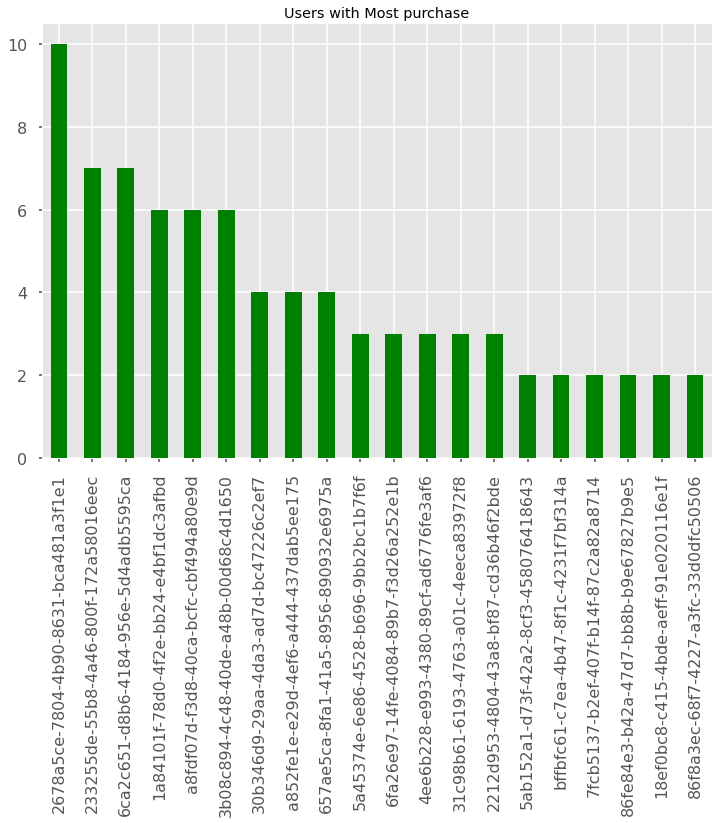

In [156]:
purchase_df.buyer_uuid.value_counts().head(20).plot(kind='bar', legend = False, color = 'green',figsize=(12,8), title='Users with Most purchase')

##### Time and Purchase

In [157]:
purchase_df["date"] = pd.to_datetime(purchase_df.date, cache=True)

print("Start Of The Period: " , purchase_df.date.min())
print("End Of The Period  : " , purchase_df.date.max() )
print("Time Period        : " , purchase_df.date.max() - purchase_df.date.min())

Start Of The Period:  2017-02-03 14:29:37
End Of The Period  :  2019-11-22 13:52:43
Time Period        :  1021 days 23:23:06


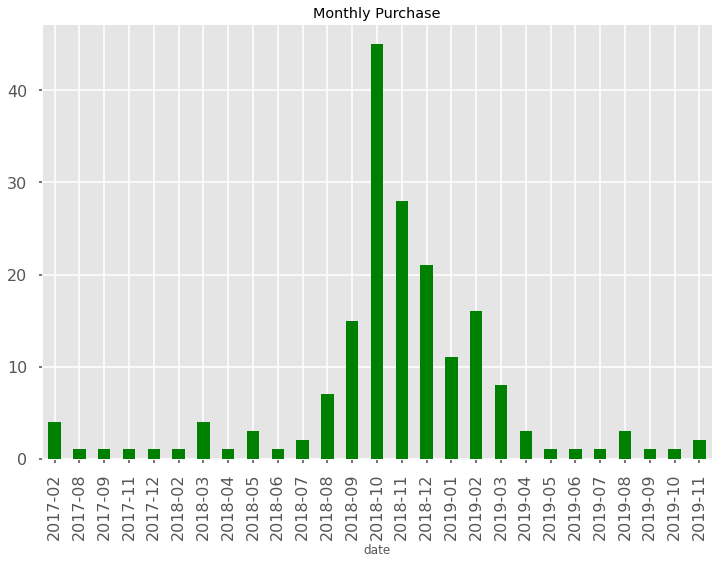

In [158]:
purchase_month_count = pd.DataFrame(purchase_df.groupby(pd.to_datetime(purchase_df["date"]).dt.to_period('M'))['product_uuid'].count()).plot(kind='bar', legend = False, 
                                                                                                                                             color = 'green',figsize=(12,8), 
                                                                                                                                             title='Monthly Purchase')

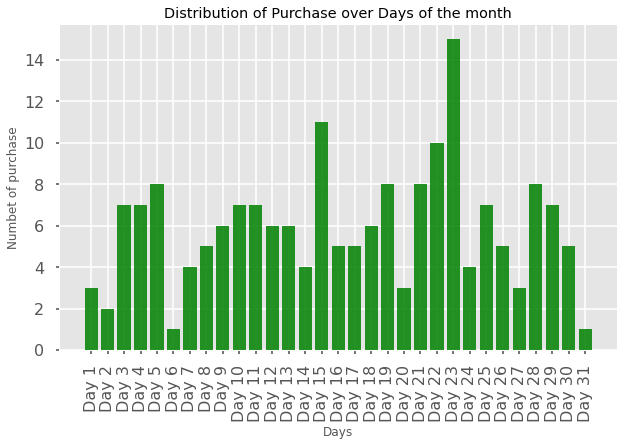

In [159]:
# Daily distribution count
daily_count = purchase_df.groupby(purchase_df["date"].dt.day, as_index = False).count()

fig= plt.figure(figsize=(10,6))

# Choose the names of the bars
bars = []
for i in range(1,32):
    bars.append('Day '+str(i))

y_pos = np.arange(len(bars))
 
# Create bars
plt.bar(y_pos, daily_count.date, color = 'green', alpha = 0.85)
 
# Create names on the x-axis
plt.xticks(y_pos, bars, rotation=90)
plt.yticks()

# Add title and axis names
plt.title('Distribution of Purchase over Days of the month')
plt.xlabel('Days', fontsize='12')
plt.ylabel('Numbet of purchase')

 
# Show graphic
plt.savefig('Images/Distribution of purchase over days.png',bbox_inches = 'tight')
plt.show()

Text(0, 0.5, 'Number Of Purchase')

<Figure size 720x432 with 0 Axes>

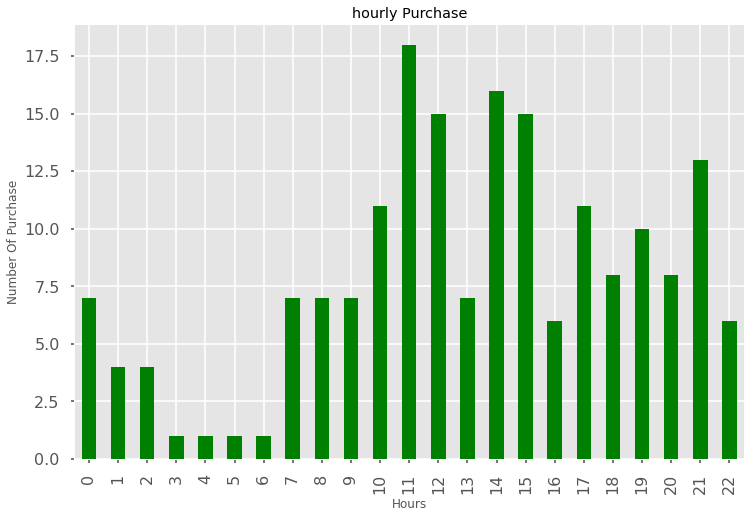

In [160]:
fig= plt.figure(figsize=(10,6))
hourly_count = purchase_df.groupby(purchase_df["date"].dt.hour, as_index = False)['date'].count().plot(kind='bar', legend = False, 
                                                                                                       color = 'green',figsize=(12,8), 
                                                                                                       title='hourly Purchase')

plt.xlabel('Hours', fontsize='12')
plt.ylabel('Number Of Purchase')

## Join tables
1. join User table & Follow table
2. Join Product table & Purchase table
    * season cost average

#### user follow Dataframe

In [161]:
users_df.head(2)

,uuid,city_uuid,gender,date,month
0,06abe0e5-c408-4a33-9d81-5bfacc891f15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10
1,33d7f40c-ab30-4517-881c-24d61acc62b8,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10


In [162]:
users_df.rename(columns = {'uuid': 'userid', 'city_uuid' : 'city_userid', 'gender':'user_gender', 'date' : 'user_date_register' , }, inplace =True)
users_df.head(2)

,userid,city_userid,user_gender,user_date_register,month
0,06abe0e5-c408-4a33-9d81-5bfacc891f15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10
1,33d7f40c-ab30-4517-881c-24d61acc62b8,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10


In [163]:
follows_df.head(2)

,user_uuid,follow_uuid,date
0,7effce15-12ba-469c-b4b4-b529425488db,372fe527-470c-48a3-a95e-fe32cc4bcc15,2018-10-05 18:47:56
1,f262a138-9585-4570-9d2d-6815c4d8b6a6,ca28e52f-ad3f-4ad8-8722-4a0fa355cbcd,2020-06-29 14:57:37


In [164]:
follows_df.rename(columns = {'user_uuid': 'userid', 'follow_uuid' : 'follow_userid', 'date' : 'date_follow' }, inplace =True)
follows_df.head(2)

,userid,follow_userid,date_follow
0,7effce15-12ba-469c-b4b4-b529425488db,372fe527-470c-48a3-a95e-fe32cc4bcc15,2018-10-05 18:47:56
1,f262a138-9585-4570-9d2d-6815c4d8b6a6,ca28e52f-ad3f-4ad8-8722-4a0fa355cbcd,2020-06-29 14:57:37


In [165]:
user_follow_df = pd.merge(users_df, follows_df, on='userid')
user_follow_df.head()

,userid,city_userid,user_gender,user_date_register,month,follow_userid,date_follow
0,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,8608a01b-09e9-487f-a1d4-15309222973a,2017-09-19 16:05:31
1,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-09-18 23:37:51
2,331739cb-6aa3-4689-b002-ff1ba9014532,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,233255de-55b8-4a46-800f-172a58016eec,2018-07-04 20:01:25
3,372fe527-470c-48a3-a95e-fe32cc4bcc15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-04-02 01:30:04
4,2ac6cb5f-c758-43c4-9d77-3b61831998a2,907bef2e-4846-44a8-bea1-c5e77c3a328d,1,2017-10-10 00:14:33,2017-10,1ed79a26-26f7-4ce9-a711-a4fe0ea5e285,2019-04-23 00:42:15


In [166]:
user_follow_df.shape

(5886, 7)

In [167]:
user_follow_df.dropna()

,userid,city_userid,user_gender,user_date_register,month,follow_userid,date_follow
0,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,8608a01b-09e9-487f-a1d4-15309222973a,2017-09-19 16:05:31
1,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-09-18 23:37:51
2,331739cb-6aa3-4689-b002-ff1ba9014532,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,233255de-55b8-4a46-800f-172a58016eec,2018-07-04 20:01:25
3,372fe527-470c-48a3-a95e-fe32cc4bcc15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-04-02 01:30:04
4,2ac6cb5f-c758-43c4-9d77-3b61831998a2,907bef2e-4846-44a8-bea1-c5e77c3a328d,1,2017-10-10 00:14:33,2017-10,1ed79a26-26f7-4ce9-a711-a4fe0ea5e285,2019-04-23 00:42:15
...,...,...,...,...,...,...,...
5881,a8ebeeaa-456d-4c52-87b6-af933bb0f996,da6236de-bc72-4abb-97db-c8065d36c366,1,2018-10-31 18:26:10,2018-10,d98c1170-5f2a-446d-aa26-5beef1f054cf,2018-11-07 10:32:06
5882,a8ebeeaa-456d-4c52-87b6-af933bb0f996,da6236de-bc72-4abb-97db-c8065d36c366,1,2018-10-31 18:26:10,2018-10,17fc2fcd-55d4-4342-a553-302e56d6d816,2018-10-31 18:50:33
5883,824abc12-e8d1-478b-94bf-576ba68a6159,49233767-888b-43fc-8441-9698f45417f6,1,2018-10-31 19:18:43,2018-10,e5b4f882-7dca-4e63-a665-f412cb383e39,2018-11-24 18:22:32
5884,f5602717-0ece-475a-ab77-c5c0e822ff53,308873a5-249c-4bd3-b721-9e5aa54cd0ce,1,2018-10-31 19:43:47,2018-10,114a3247-5226-460f-850f-3d53ad112ed1,2019-08-28 23:50:50


In [168]:
# Chech for Null Value
missing_percentage = user_follow_df.isnull().sum() / user_follow_df.shape[0] * 100
missing_percentage

userid               0.000
city_userid          0.000
user_gender          0.000
user_date_register   0.000
month                0.000
follow_userid        0.000
date_follow          0.000
dtype: float64

In [169]:
user_follow_df.head(2)

,userid,city_userid,user_gender,user_date_register,month,follow_userid,date_follow
0,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,8608a01b-09e9-487f-a1d4-15309222973a,2017-09-19 16:05:31
1,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-09-18 23:37:51


In [170]:
# All the users in this dataset are male so we drop user_gender column in order to make our data more readable
user_follow_df.drop(columns= 'user_gender', inplace =True )

#### more Socialable cities

In [171]:
# user_follow_df.groupby(pd.to_datetime(products_df["date"]).dt.to_period('M'))['uuid'].count().plot(kind='bar')

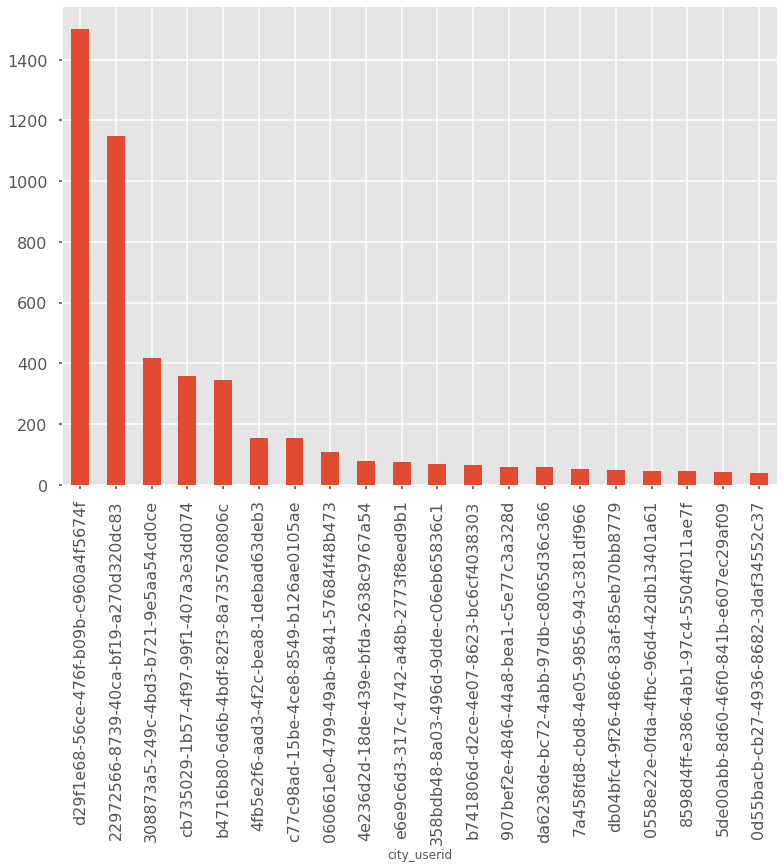

In [172]:
user_follow_df.groupby('city_userid')['userid'].count().nlargest(20).plot(kind='bar')

#### Time between registeration and first follow

In [173]:
user_follow_df.head(2)

,userid,city_userid,user_date_register,month,follow_userid,date_follow
0,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,2017-10-10 00:14:33,2017-10,8608a01b-09e9-487f-a1d4-15309222973a,2017-09-19 16:05:31
1,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-09-18 23:37:51


In [174]:
user_follow_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5886 entries, 0 to 5885
Data columns (total 6 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   userid              5886 non-null   object        
 1   city_userid         5886 non-null   object        
 2   user_date_register  5886 non-null   datetime64[ns]
 3   month               5886 non-null   period[M]     
 4   follow_userid       5886 non-null   object        
 5   date_follow         5886 non-null   object        
dtypes: datetime64[ns](1), object(4), period[M](1)
memory usage: 321.9+ KB


In [175]:
user_follow_df['time_dif'] = pd.to_datetime(user_follow_df['date_follow']) - pd.to_datetime(user_follow_df['user_date_register'])
user_follow_df.head()

,userid,city_userid,user_date_register,month,follow_userid,date_follow,time_dif
0,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,2017-10-10 00:14:33,2017-10,8608a01b-09e9-487f-a1d4-15309222973a,2017-09-19 16:05:31,-21 days +15:50:58
1,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-09-18 23:37:51,-22 days +23:23:18
2,331739cb-6aa3-4689-b002-ff1ba9014532,22972566-8739-40ca-bf19-a270d320dc83,2017-10-10 00:14:33,2017-10,233255de-55b8-4a46-800f-172a58016eec,2018-07-04 20:01:25,267 days 19:46:52
3,372fe527-470c-48a3-a95e-fe32cc4bcc15,22972566-8739-40ca-bf19-a270d320dc83,2017-10-10 00:14:33,2017-10,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-04-02 01:30:04,-191 days +01:15:31
4,2ac6cb5f-c758-43c4-9d77-3b61831998a2,907bef2e-4846-44a8-bea1-c5e77c3a328d,2017-10-10 00:14:33,2017-10,1ed79a26-26f7-4ce9-a711-a4fe0ea5e285,2019-04-23 00:42:15,560 days 00:27:42


In [176]:
# It seems that our data has some problem with regards to time!
# let's double check to be sure!


In [177]:
users_df[users_df['userid'] == '634edd5c-318e-40ec-aeb9-1e863836754d']

,userid,city_userid,user_gender,user_date_register,month
4,634edd5c-318e-40ec-aeb9-1e863836754d,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10


In [178]:
follows_df[follows_df['userid'] == '634edd5c-318e-40ec-aeb9-1e863836754d']

,userid,follow_userid,date_follow
324,634edd5c-318e-40ec-aeb9-1e863836754d,8608a01b-09e9-487f-a1d4-15309222973a,2017-09-19 16:05:31
416,634edd5c-318e-40ec-aeb9-1e863836754d,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,2017-09-18 23:37:51


The user with **634edd5c-318e-40ec-aeb9-1e863836754d** regiester on **2017-10-10 00:14:33** and follow two other user on **2017-09-19 16:05:3** and **2017-09-18 23:37:51**, which is impossible!

#### product_purchase Dataframe

In [179]:
products_df.head(2)

,uuid,user_uuid,category_uuid,city_uuid,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,gender,date,discount
10814,56d54b87-3a0f-4164-94d5-0217aa7bb8de,a9502826-05f5-4551-84b7-4ab459715245,aa9c2861-90e8-4210-994b-332ecab092fd,1b1f27b2-40da-4fa7-bec4-697dca294770,1,0,2147483647,10000,0,1,1,2019-12-19 02:42:28,2147473647
638,f7858eea-4370-410f-a77d-1260376e9f9f,85ba8dcc-eab6-47fb-a112-0f4fe72ef5a0,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,0,0,2147483647,25000,0,1,1,2019-12-19 02:42:28,2147458647


In [180]:
products_df.rename(columns = {'uuid': 'productid', 'user_uuid' : 'userid', 'city_uuid': 'city_product_id', 'gender':'product_gender', 'date' : 'product_date_register' , }, inplace =True)
products_df.head(2)

,productid,userid,category_uuid,city_product_id,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,product_gender,product_date_register,discount
10814,56d54b87-3a0f-4164-94d5-0217aa7bb8de,a9502826-05f5-4551-84b7-4ab459715245,aa9c2861-90e8-4210-994b-332ecab092fd,1b1f27b2-40da-4fa7-bec4-697dca294770,1,0,2147483647,10000,0,1,1,2019-12-19 02:42:28,2147473647
638,f7858eea-4370-410f-a77d-1260376e9f9f,85ba8dcc-eab6-47fb-a112-0f4fe72ef5a0,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,0,0,2147483647,25000,0,1,1,2019-12-19 02:42:28,2147458647


In [181]:
purchase_df.head(2)

,buyer_uuid,product_uuid,count,date
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52
1,970ef8d9-c50e-4821-9687-145379af2b9a,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16


In [182]:
purchase_df.rename(columns = {'product_uuid': 'productid', 'date' : 'date_purchase' }, inplace =True)
purchase_df.head(2)

,buyer_uuid,productid,count,date_purchase
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52
1,970ef8d9-c50e-4821-9687-145379af2b9a,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16


In [183]:
product_purchase_df = pd.merge(products_df, purchase_df, on='productid')
product_purchase_df.head(2)

,productid,userid,category_uuid,city_product_id,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,product_gender,product_date_register,discount,buyer_uuid,count,date_purchase
0,52b9d9de-708b-4d79-9435-bb5175f50ee8,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,1,0,2800000,80000,0,14,1,2019-12-19 02:42:28,2720000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-02-04 17:42:28
1,58334645-bd86-481c-bd78-cdfc4b42a201,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,0,0,2000000,50000,0,25,1,2019-12-19 02:42:28,1950000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-01-03 21:23:20


In [184]:
product_purchase_df.shape

(184, 16)

In [185]:
product_purchase_df.dropna()

,productid,userid,category_uuid,city_product_id,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,product_gender,product_date_register,discount,buyer_uuid,count,date_purchase
0,52b9d9de-708b-4d79-9435-bb5175f50ee8,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,1,0,2800000,80000,0,14,1,2019-12-19 02:42:28,2720000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-02-04 17:42:28
1,58334645-bd86-481c-bd78-cdfc4b42a201,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,0,0,2000000,50000,0,25,1,2019-12-19 02:42:28,1950000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-01-03 21:23:20
2,57a3a4ae-525e-490a-9109-16ade75d30d5,a29806a8-fa15-4c64-a75d-05de6798d53f,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,680000,50000,0,3,1,2019-12-19 02:42:28,630000,31c98b61-6193-4763-a01c-4eeca83972f8,1,2018-10-10 11:17:55
3,f7e69ba3-9a3f-4e7e-adaf-68b4c88395b5,7ff60783-190e-4bcb-a78a-0ba20f469e3e,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,1,0,880000,350000,0,18,1,2019-12-19 02:42:28,530000,8c5a7228-e794-4b14-b9cb-91e2156c9c2c,1,2018-10-26 23:13:27
4,2a4a1882-445d-4b73-b3d3-ba3c94e58b18,1aa167b8-0ebf-4d43-8853-33c3faf539d6,aa9c2861-90e8-4210-994b-332ecab092fd,308873a5-249c-4bd3-b721-9e5aa54cd0ce,0,0,370000,5000,0,3,1,2019-12-19 02:42:28,365000,20afdbd8-d0c2-40ea-bf0c-9302a0c9e236,1,2018-10-24 21:57:27
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
179,a5d8e285-8251-4348-9849-e99bd64bb4e9,233255de-55b8-4a46-800f-172a58016eec,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,33000,0,9,1,2019-12-19 02:42:28,-33000,3b08c894-4c48-40de-a48b-00d68c4d1650,1,2018-09-10 19:59:01
180,0cd2b781-bd44-40cf-9422-a50dac21f4b5,498439f1-52ed-4e3d-b07a-fe77061837b5,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,35000,0,0,1,2019-12-19 02:42:28,-35000,233255de-55b8-4a46-800f-172a58016eec,1,2018-03-12 20:26:13
181,35b5cb78-c42e-4542-aa84-594897150568,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,3be89fba-3211-44de-917d-2a968dabcf38,22972566-8739-40ca-bf19-a270d320dc83,1,0,0,40000,0,16,1,2019-12-19 02:42:28,-40000,4ee6b228-e993-4380-89cf-ad6776fe3af6,1,2018-12-19 10:52:36
182,fa490d30-9fd5-4c52-afb7-fb4b5a1fe93f,b629b255-1f46-4a92-b6d1-5d67b1ad8c54,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,1,0,0,55000,0,1,1,2019-12-19 02:42:28,-55000,770728cb-3f6c-4230-af5c-19cb9684be16,1,2017-02-25 12:19:12


In [186]:
# Chech for Null Value
missing_percentage = product_purchase_df.isnull().sum() / product_purchase_df.shape[0] * 100
missing_percentage

productid               0.000
userid                  0.000
category_uuid           0.000
city_product_id         0.000
is_new                  0.000
is_homemade             0.000
original_price          0.000
price                   0.000
comments_count          0.000
bookmarks_count         0.000
product_gender          0.000
product_date_register   0.000
discount                0.000
buyer_uuid              0.000
count                   0.000
date_purchase           0.000
dtype: float64

In [187]:
product_purchase_df.head(2)

,productid,userid,category_uuid,city_product_id,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,product_gender,product_date_register,discount,buyer_uuid,count,date_purchase
0,52b9d9de-708b-4d79-9435-bb5175f50ee8,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,1,0,2800000,80000,0,14,1,2019-12-19 02:42:28,2720000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-02-04 17:42:28
1,58334645-bd86-481c-bd78-cdfc4b42a201,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,0,0,2000000,50000,0,25,1,2019-12-19 02:42:28,1950000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-01-03 21:23:20


#### category with most purchase

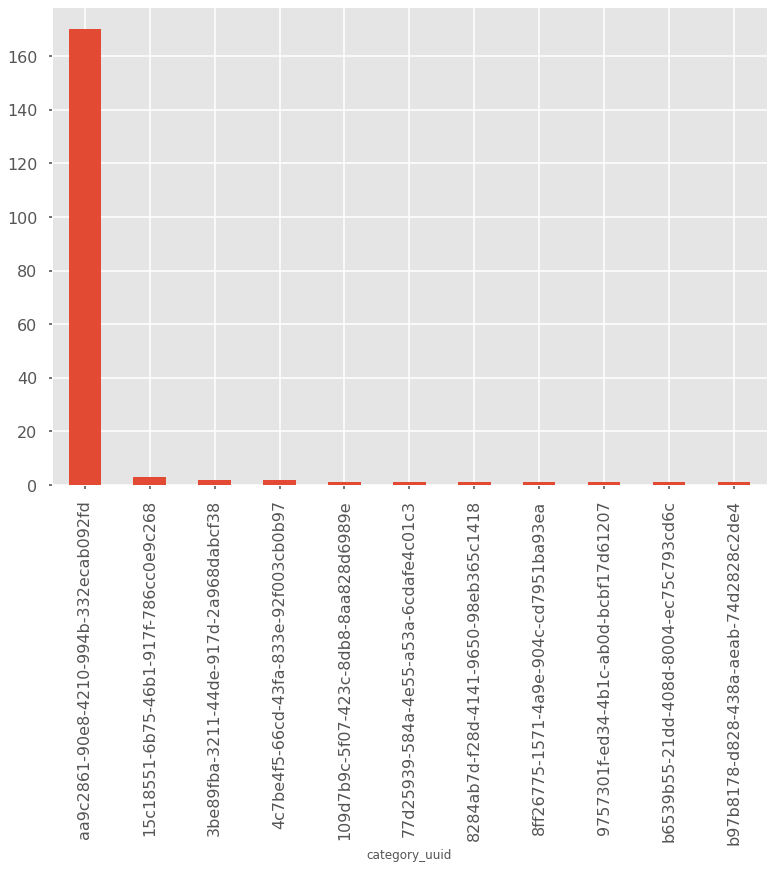

In [188]:
product_purchase_df.groupby('category_uuid')['category_uuid'].count().nlargest(20).plot(kind='bar')

#### cities with most successful sales!

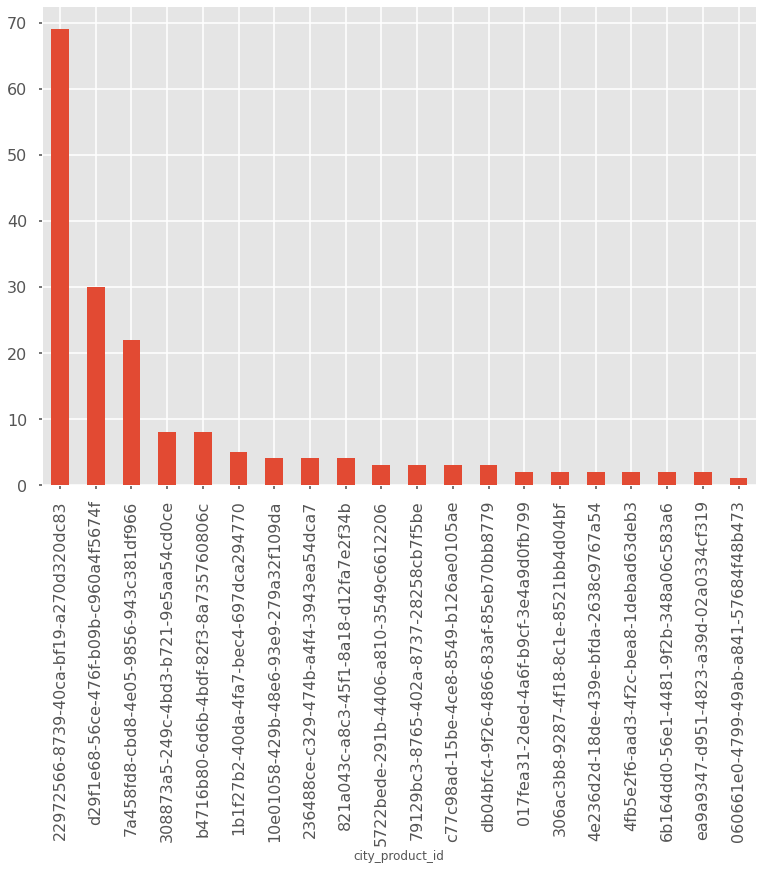

In [189]:
product_purchase_df.groupby('city_product_id')['city_product_id'].count().nlargest(20).plot(kind='bar')

#### Which one sales better? New or Old?

Text(0, 0.5, 'Frequency')

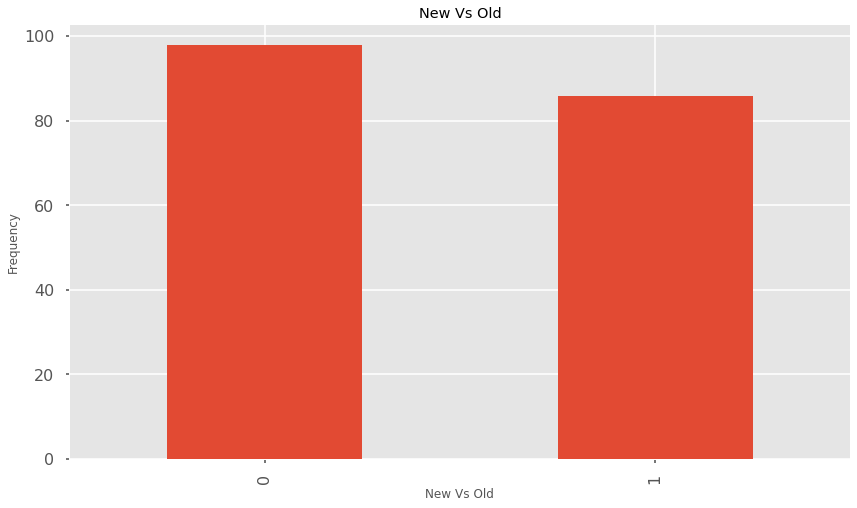

In [190]:
ax = product_purchase_df['is_new'].value_counts().plot(kind='bar',
                                    figsize=(14,8),
                                    title="New Vs Old")
ax.set_xlabel("New Vs Old")
ax.set_ylabel("Frequency")

#### Which one sales better? homemade or Manufactured?

Text(0, 0.5, 'Frequency')

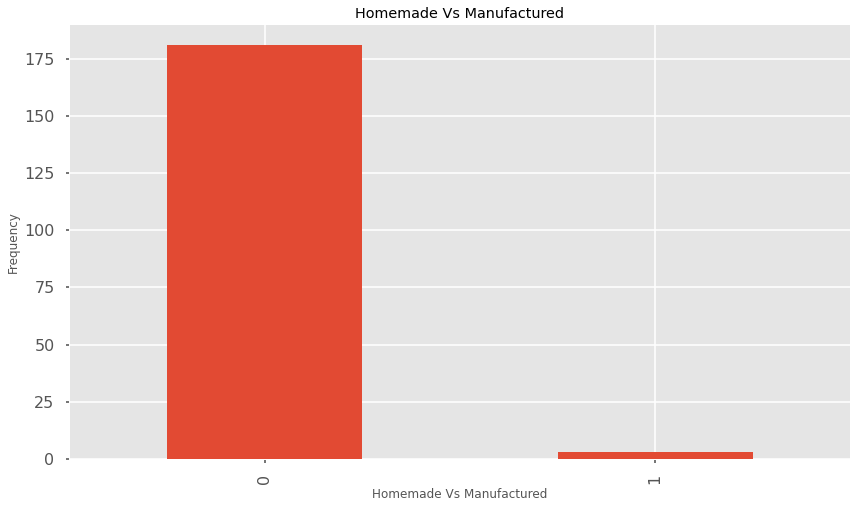

In [191]:
ax = product_purchase_df['is_homemade'].value_counts().plot(kind='bar',
                                    figsize=(14,8),
                                    title="Homemade Vs Manufactured")
ax.set_xlabel("Homemade Vs Manufactured")
ax.set_ylabel("Frequency")

#### How long does it take to sale a product on average?

In [192]:
product_purchase_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 184 entries, 0 to 183
Data columns (total 16 columns):
 #   Column                 Non-Null Count  Dtype         
---  ------                 --------------  -----         
 0   productid              184 non-null    object        
 1   userid                 184 non-null    object        
 2   category_uuid          184 non-null    object        
 3   city_product_id        184 non-null    object        
 4   is_new                 184 non-null    int64         
 5   is_homemade            184 non-null    int64         
 6   original_price         184 non-null    int64         
 7   price                  184 non-null    int64         
 8   comments_count         184 non-null    int64         
 9   bookmarks_count        184 non-null    int64         
 10  product_gender         184 non-null    int64         
 11  product_date_register  184 non-null    datetime64[ns]
 12  discount               184 non-null    int64         
 13  buyer

In [193]:
product_purchase_df['time_dif'] = pd.to_datetime(product_purchase_df['date_purchase']) - pd.to_datetime(product_purchase_df['product_date_register'])
product_purchase_df.head()

,productid,userid,category_uuid,city_product_id,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,product_gender,product_date_register,discount,buyer_uuid,count,date_purchase,time_dif
0,52b9d9de-708b-4d79-9435-bb5175f50ee8,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,1,0,2800000,80000,0,14,1,2019-12-19 02:42:28,2720000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-02-04 17:42:28,-318 days +15:00:00
1,58334645-bd86-481c-bd78-cdfc4b42a201,31c98b61-6193-4763-a01c-4eeca83972f8,aa9c2861-90e8-4210-994b-332ecab092fd,7a458fd8-cbd8-4e05-9856-943c381df966,0,0,2000000,50000,0,25,1,2019-12-19 02:42:28,1950000,2678a5ce-7804-4b90-8631-bca481a3f1e1,1,2019-01-03 21:23:20,-350 days +18:40:52
2,57a3a4ae-525e-490a-9109-16ade75d30d5,a29806a8-fa15-4c64-a75d-05de6798d53f,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,680000,50000,0,3,1,2019-12-19 02:42:28,630000,31c98b61-6193-4763-a01c-4eeca83972f8,1,2018-10-10 11:17:55,-435 days +08:35:27
3,f7e69ba3-9a3f-4e7e-adaf-68b4c88395b5,7ff60783-190e-4bcb-a78a-0ba20f469e3e,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,1,0,880000,350000,0,18,1,2019-12-19 02:42:28,530000,8c5a7228-e794-4b14-b9cb-91e2156c9c2c,1,2018-10-26 23:13:27,-419 days +20:30:59
4,2a4a1882-445d-4b73-b3d3-ba3c94e58b18,1aa167b8-0ebf-4d43-8853-33c3faf539d6,aa9c2861-90e8-4210-994b-332ecab092fd,308873a5-249c-4bd3-b721-9e5aa54cd0ce,0,0,370000,5000,0,3,1,2019-12-19 02:42:28,365000,20afdbd8-d0c2-40ea-bf0c-9302a0c9e236,1,2018-10-24 21:57:27,-421 days +19:14:59


It seems that we have the same problem here with this table too!
let's double check to make sure!

In [194]:
products_df.head(2)

,productid,userid,category_uuid,city_product_id,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,product_gender,product_date_register,discount
10814,56d54b87-3a0f-4164-94d5-0217aa7bb8de,a9502826-05f5-4551-84b7-4ab459715245,aa9c2861-90e8-4210-994b-332ecab092fd,1b1f27b2-40da-4fa7-bec4-697dca294770,1,0,2147483647,10000,0,1,1,2019-12-19 02:42:28,2147473647
638,f7858eea-4370-410f-a77d-1260376e9f9f,85ba8dcc-eab6-47fb-a112-0f4fe72ef5a0,aa9c2861-90e8-4210-994b-332ecab092fd,d29f1e68-56ce-476f-b09b-c960a4f5674f,0,0,2147483647,25000,0,1,1,2019-12-19 02:42:28,2147458647


In [195]:
products_df[products_df['productid'] == '0cd2b781-bd44-40cf-9422-a50dac21f4b5']

,productid,userid,category_uuid,city_product_id,is_new,is_homemade,original_price,price,comments_count,bookmarks_count,product_gender,product_date_register,discount
44,0cd2b781-bd44-40cf-9422-a50dac21f4b5,498439f1-52ed-4e3d-b07a-fe77061837b5,aa9c2861-90e8-4210-994b-332ecab092fd,22972566-8739-40ca-bf19-a270d320dc83,0,0,0,35000,0,0,1,2019-12-19 02:42:28,-35000


In [196]:
purchase_df[purchase_df['productid'] == '0cd2b781-bd44-40cf-9422-a50dac21f4b5']

,buyer_uuid,productid,count,date_purchase
4,233255de-55b8-4a46-800f-172a58016eec,0cd2b781-bd44-40cf-9422-a50dac21f4b5,1,2018-03-12 20:26:13


The product with **0cd2b781-bd44-40cf-9422-a50dac21f4b5** regiester on **2019-12-19 02:42:28** and sold on **2018-03-12 20:26:13**, which is impossible!

#### user_purchase Dataframe

In [197]:
users_df.head(2)

,userid,city_userid,user_gender,user_date_register,month
0,06abe0e5-c408-4a33-9d81-5bfacc891f15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10
1,33d7f40c-ab30-4517-881c-24d61acc62b8,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10


In [198]:
purchase_df.head(2)

,buyer_uuid,productid,count,date_purchase
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52
1,970ef8d9-c50e-4821-9687-145379af2b9a,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16


In [199]:
purchase_df.rename(columns = {'buyer_uuid': 'userid'}, inplace = True)
purchase_df.head(2)

,userid,productid,count,date_purchase
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52
1,970ef8d9-c50e-4821-9687-145379af2b9a,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16


In [200]:
user_purchase_df = pd.merge(users_df, purchase_df, on='userid')
user_purchase_df.head()

,userid,city_userid,user_gender,user_date_register,month,productid,count,date_purchase
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52
1,970ef8d9-c50e-4821-9687-145379af2b9a,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16
2,970ef8d9-c50e-4821-9687-145379af2b9a,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,ecd1b68f-9db4-49f5-bac5-5679d9f9d784,1,2018-03-01 15:10:23
3,0bc6742f-d58a-4539-b85b-62bc3463033b,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,af59299c-2d08-4993-9be0-cfd7e641ae0d,1,2017-12-17 12:49:20
4,233255de-55b8-4a46-800f-172a58016eec,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,0cd2b781-bd44-40cf-9422-a50dac21f4b5,1,2018-03-12 20:26:13


In [201]:
user_purchase_df.shape

(184, 8)

In [202]:
user_purchase_df.dropna()

,userid,city_userid,user_gender,user_date_register,month,productid,count,date_purchase
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52
1,970ef8d9-c50e-4821-9687-145379af2b9a,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16
2,970ef8d9-c50e-4821-9687-145379af2b9a,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,ecd1b68f-9db4-49f5-bac5-5679d9f9d784,1,2018-03-01 15:10:23
3,0bc6742f-d58a-4539-b85b-62bc3463033b,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,af59299c-2d08-4993-9be0-cfd7e641ae0d,1,2017-12-17 12:49:20
4,233255de-55b8-4a46-800f-172a58016eec,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,0cd2b781-bd44-40cf-9422-a50dac21f4b5,1,2018-03-12 20:26:13
...,...,...,...,...,...,...,...,...
179,af9048ee-3109-483c-b710-ed0fd8dbe41c,cb735029-1b57-4f97-99f1-407a3e3dd074,1,2018-10-25 12:18:46,2018-10,d6d66059-e6a5-4309-a864-e0076d0d934e,1,2018-10-29 12:17:37
180,8abf1063-e8d4-4630-83e0-b139cfebb37f,060661e0-4799-49ab-a841-57684f48b473,1,2018-10-25 18:41:59,2018-10,7b9fb23f-8598-4752-8c0c-352e568769a5,1,2018-11-23 14:01:24
181,e5789a70-db24-483e-8d3f-85002011d954,a200397b-66c5-4161-8280-cc2bcafedfed,1,2018-10-28 09:48:01,2018-10,290cf9b3-a7ad-4820-85c9-7493e32256e2,1,2018-11-14 22:49:40
182,61c3b4b1-e33a-47d6-b62a-3dd2c78e4497,7a458fd8-cbd8-4e05-9856-943c381df966,1,2018-10-28 18:13:39,2018-10,8cd5bef7-9c1f-4d47-ad90-b350356f0883,1,2018-12-07 20:06:18


In [203]:
# Chech for Null Value
missing_percentage = user_purchase_df.isnull().sum() / user_purchase_df.shape[0] * 100
missing_percentage

userid               0.000
city_userid          0.000
user_gender          0.000
user_date_register   0.000
month                0.000
productid            0.000
count                0.000
date_purchase        0.000
dtype: float64

#### Users with most purchases

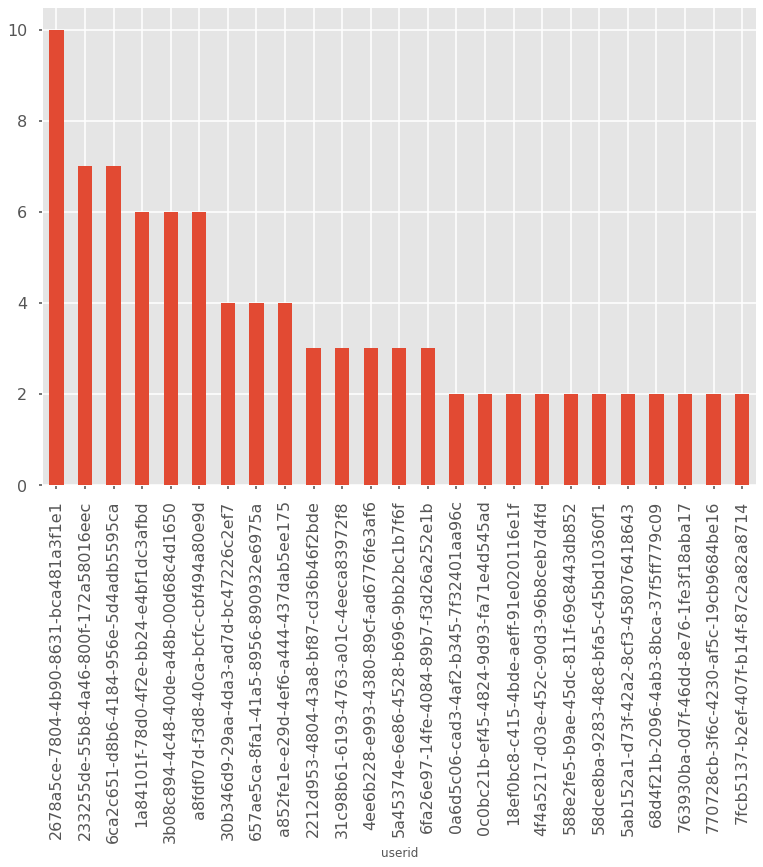

In [204]:
user_purchase_df.groupby('userid')['userid'].count().nlargest(25).plot(kind='bar')

#### cities with most purchases

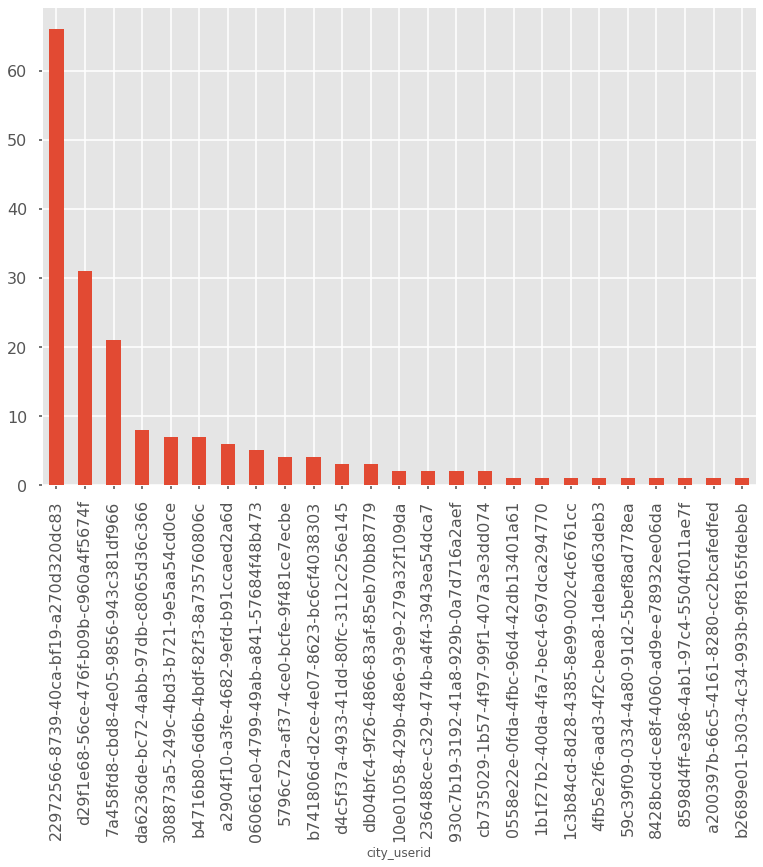

In [205]:
user_purchase_df.groupby('city_userid')['city_userid'].count().nlargest(25).plot(kind='bar')

#### Time between registeration and first purchase

In [206]:
user_purchase_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 184 entries, 0 to 183
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype         
---  ------              --------------  -----         
 0   userid              184 non-null    object        
 1   city_userid         184 non-null    object        
 2   user_gender         184 non-null    int64         
 3   user_date_register  184 non-null    datetime64[ns]
 4   month               184 non-null    period[M]     
 5   productid           184 non-null    object        
 6   count               184 non-null    int64         
 7   date_purchase       184 non-null    datetime64[ns]
dtypes: datetime64[ns](2), int64(2), object(3), period[M](1)
memory usage: 12.9+ KB


In [207]:
user_purchase_df['time_dif'] = pd.to_datetime(user_purchase_df['date_purchase']) - pd.to_datetime(user_purchase_df['user_date_register'])
user_purchase_df.head()

,userid,city_userid,user_gender,user_date_register,month,productid,count,date_purchase,time_dif
0,372fe527-470c-48a3-a95e-fe32cc4bcc15,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,99863785-21e9-4ebc-ae7a-8c558d8421b4,1,2018-02-15 17:38:52,128 days 17:24:19
1,970ef8d9-c50e-4821-9687-145379af2b9a,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16,-236 days +00:32:43
2,970ef8d9-c50e-4821-9687-145379af2b9a,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,ecd1b68f-9db4-49f5-bac5-5679d9f9d784,1,2018-03-01 15:10:23,142 days 14:55:50
3,0bc6742f-d58a-4539-b85b-62bc3463033b,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,af59299c-2d08-4993-9be0-cfd7e641ae0d,1,2017-12-17 12:49:20,68 days 12:34:47
4,233255de-55b8-4a46-800f-172a58016eec,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10,0cd2b781-bd44-40cf-9422-a50dac21f4b5,1,2018-03-12 20:26:13,153 days 20:11:40


And again the same problem!

In [208]:
users_df[users_df['userid'] == '970ef8d9-c50e-4821-9687-145379af2b9a']

,userid,city_userid,user_gender,user_date_register,month
41,970ef8d9-c50e-4821-9687-145379af2b9a,22972566-8739-40ca-bf19-a270d320dc83,1,2017-10-10 00:14:33,2017-10


In [209]:
purchase_df[purchase_df['userid'] == '970ef8d9-c50e-4821-9687-145379af2b9a']

,userid,productid,count,date_purchase
1,970ef8d9-c50e-4821-9687-145379af2b9a,e68a5832-7292-4a54-ad92-02f31a46494c,1,2017-02-16 00:47:16
2,970ef8d9-c50e-4821-9687-145379af2b9a,ecd1b68f-9db4-49f5-bac5-5679d9f9d784,1,2018-03-01 15:10:23


User **970ef8d9-c50e-4821-9687-145379af2b9a** make a purchase twice and one of which is **-236 days** before he/she register to the website!